# ACSE-7 (Inversion and Optimisation)  <a class="tocSkip"></a>

# Coursework: airfoils and shape optimisation <a class="tocSkip"></a>

Any questions: s.kramer@imperial.ac.uk

The coursework for this module consists of a technical report (and the code used therein) about the development of a framework to study the flow around an airfoil with the capability to optimise the shape of the airfoil. This will be based on some existing potential flow code to model the 2D flow around an airfoil cross section. Your task is to investigate what the most efficient solvers are that should be used for this code, and to add some missing components needed to use this code in an airfoil shape optimisation.

Submission is via github classrooms: https://classroom.github.com/a/_ec7cBii. The deadline for submission is Friday, March the 1st at 4PM.

The technical report should be in the form of a single jupyter notebook, addressing the points listed below. Imagine you write this report for someone (or say a company) who is already familiar with the physics of the problem and how it is discretized, but who has hired you to apply your expertise to find the most efficient solver strategy for the code and to develop the optimisation capability. As in every good technical report, it should contain the reasoning and the analysis behind the choices that were made. There should be some test results to verify the correctness of the new functionality and some validation to show that predictions made by the model can be trusted. Finally, there should be some user documentation that shows how the new optimisation functionality can be used.

Although this project does not require extensive code development, the code you do add should be well documented and commented. You may use any code given in the four notebooks that were distributed during this course, and the provided `potential_flow` and `panel_method_derivatives` python modules, and rely on the same external libraries as used in the four notebooks: scipy, matplotlib, mpltools, triangle, pyamg, and sympy. The functionality you show in the technical report should work based on the code in your github project. You may structure it in any way you prefer, but there should be clear instructions on how to use it. You are very much encouraged to adapt the given code to your needs. You may include the `potential_flow` and `panel_method_derivatives` modules as a whole in your project, but please keep any additions and changes to these separate. You should include tests with your code and instructions on how to run these.

The following is a list of items that should be included in the technical report. Try to keep these items separate in the report and clearly indicate them, so they can be marked correctly. For each item it is indicated which questions in the four coursework notebooks you should base this on. Make sure that the answer to every question is included (unless indicated otherwise). As far as possible include the code you have used to obtain any results you show.  In most cases you should be able to copy and paste the code and results if you have first done this inside one of the coursework notebooks, but please make sure the code in the technical report notebook still runs. For results (e.g. graphs and timings based on multiple runs) that would take some time to rerun however, it is absolutely fine to just copy the results and only check that your code still works for a small case. In the final technical report notebook that you commit to your repository, all output of any code cells should be included.

## Items based on notebook one and three: <a class="tocSkip"></a>

# 1. Solver Configuration for the Finite Element Potential Flow Model (10 points) <a class="tocSkip"></a>
Recommend the most efficient way to solve the first potential flow finite element model implemented in the `PotentialFlowFE` class from the `potential_flow` module. This is the exact same solver that was also used in part one. Give the reasons for your choice, and show the analysis you have done to make that decision. This should be based on question 1. to 4. in notebook one, and question 1 to 3. in notebook three.

## Reccomendation
the most efficient way to solve the first potential flow finite element model implemented in the `PotentialFlowFE` class from the `potential_flow` module would be to use the AMG preconditioned CG method for resolutions smaller than 1e-4. For resolutions larger than 1e-4 the direct solver method would be the best (see questions 1-3 of notebook 3 below and the computational cost plots at the end of Q2). We decided on AMG preconditioner by first testing with 3 different preconditioners (namely Jacobi, SSOR, AMG) and see which one works the best (see Q2). The reason for chosing CG method was that in notebook 1 we showed that the matrix A was symmetic and have all positive eigenvalues (i.e. positive definitive) and we know that for positive definitive A, generally CG works the best (however, we also tested using GMRES and BICGStab to verify that CG method is indeed the best, see the last plot at the end of Q2).

# -----------------------------------1(Part3-Q1-Q3)---------------------------------------

1. Compare the performance of cg without and with different preconditioners, both in terms of time and number of iterations.

2. Compare the fastest method of question 2, with the direct sparse solver `spl.spsolve`. Is preconditioned CG actually faster now? What about if you increase the resolution? Make sure you increase the resolution by a considerable amount: change the maximum triangle area from `1e-2` to `5e-3`, `1e-3`, `5e-4`, `1e-4`, etc. Note that at some point you will run out of memory. If your results are still inconclusive for the resolutions that you can run, you may also draw conclusions based on extrapolation to argue about what would happen if you were able to run an even higher resolution case (say on a bigger computer).

3. Suppose you are thinking to extend the flow solver to 3D, based on your observations what are your expectations for what the fastest solution strategy will be in that case?

## required functions and imports for notebook 2

In [1]:
# needs to be in separate cell!
%matplotlib inline

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.linalg as sl
import scipy.sparse as sp
import scipy.sparse.linalg as spl
import triangle
from matplotlib.tri import Triangulation, LinearTriInterpolator

# ensure fonts in figures are readable:
plt.rcParams['font.size'] = 16
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial', 'Dejavu Sans']

# this module is provided with the notebook (potential_flow.py)
from potential_flow import *

# these two lines ensure that imported modules are automatically reloaded when changed
%load_ext autoreload
%autoreload 2

class SimpleCounter:
    """Simple counter object that records how many times it has been called"""
    def __init__(self):
        self.count = 0
    
    def __call__(self, *args):
        """Counts each call, ignore any arguments"""
        self.count += 1
        
import pyamg

class Preconditioner(spl.LinearOperator):
    """A base class for the preconditioners
    
    Every preconditioner needs to implement a __call__ method
    that will be called with the residual vector and should return
    the preconditioner applied to that residual vector."""
    def __init__(self, A):
        super().__init__(dtype=None, shape=A.shape)

    def __call__(self, r):
        raise NotImplemented("The call method should be overloaded")

    def _matvec(self, r):
        return self(r)


class JacobiPreconditioner(Preconditioner):
    """Jacobi preconditioner"""
    def __init__(self, A):
        super().__init__(A)
        self.diag = A.diagonal()  # extract main diagonal

    def __call__(self, r):
        return r/self.diag


class SSORPreconditioner(Preconditioner):
    """SSOR preconditioner,
    
    set 0<omega<2 to improve convergence (see lecture notes 7)."""
    def __init__(self, A, omega=1.0):
        super().__init__(A)
        self.A = A
        self.rr = np.zeros(A.shape[0])  # auxilary vector
        self.omega = omega

    def __call__(self, r):
        self.rr[:] = 0  # reset to zero
        # this step computes rr = rr + M^{-1} r
        # since we start with rr = 0, we get rr = M^{-1} r back
        pyamg.relaxation.relaxation.sor(self.A, self.rr, r, omega=self.omega, sweep='symmetric')
        return self.rr


class AMGPreconditioner(Preconditioner):
    """AMG preconditioner - wraps around pyamg's ruge_stuben_solver"""
    def __init__(self, A):
        super().__init__(A)
        ml = pyamg.ruge_stuben_solver(A.tocsr(), strength=('classical'))
        self.gamg = ml.aspreconditioner()
        
    def __call__(self, r):
        return self.gamg(r)

# ---------------------------------------Q1------------------------------------------------

below we time different preconditioners

In [3]:
#"""
# polygon describing the outer boundary
outer_boundary = [[-2, -2], [3, -2], [3, 2], [-2, 2], [-2, -2]]

# polygon describing a NACA0012 airfoil
airfoil = np.loadtxt('naca0012.dat')

resolution = 1e-2  # maximum triangle area
u_inf = 1.0
alpha = np.deg2rad(4)
pf = PotentialFlowFE(airfoil, outer_boundary, resolution, u_inf, alpha)
A, b = pf.assemble(sparse=True)


jacobi = JacobiPreconditioner(A)
ssor = SSORPreconditioner(A, omega=1.5)
amg = AMGPreconditioner(A)

counter1 = SimpleCounter()
counter2 = SimpleCounter()
counter3 = SimpleCounter()
counter = SimpleCounter()

%timeit phi =  spl.cg(A, b, tol=1e-5, callback=counter)
%timeit phi1 = spl.cg(A, b, tol=1e-5,callback=counter1, M=jacobi)
%timeit phi2 = spl.cg(A, b, tol=1e-5,callback=counter2, M=ssor)
%timeit phi3 = spl.cg(A, b, tol=1e-5,callback=counter3, M=amg)
#"""

11.9 ms ± 1.47 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)
12.2 ms ± 1.24 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)
17.3 ms ± 1.86 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)
11.2 ms ± 34.3 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [4]:
#"""
print("# Iterations (no preconditioning):", counter.count)
print("# of Iterations (jacobi preconditioning) :", counter1.count)
print("# of Iterations (ssor preconditioning) :", counter2.count)
print("# of Iterations (amg preconditioning) :", counter3.count)
#"""

# Iterations (no preconditioning): 169499
# of Iterations (jacobi preconditioning) : 158145
# of Iterations (ssor preconditioning) : 71368
# of Iterations (amg preconditioning) : 11354


## Observations

with resolution 1e-2: As expected, it is observed that preconditioning deacreases the number of iterations. The amg preconditioning decreased the number of iterations the most significantly whereas, the jacobi preconditioning deacreased the number of iterations very slightly. In terms of computation time we don't observe significant difference between no-preconditioning and jacobi/amg preconditioning (both methods take arround 11 ms per 100 loops) and ssor preconditioning seems to be slower than the no-preconditioning. This is a result of each iteration requiring more computation with pre-conditionings and with the ssor preconditioning the computational cost of each iteration is increased more than the number of iterations deacreased.

with resolution 5e-2: amg preconditioned cg is the fastest method (15.8 ms per 100 loops) compared to no-preconditioned cg (24 ms per 100 loops). Jacobi preconditioned cg (20.7 ms per 100 loops) also faster than the nopreconditioned cg. Again ssor preconditioning is the slowest (took 38 ms per 100 loops).

with resolution < 5e-2: amg preconditioned cg is the fastest method (both in terms of the number of iterations and the computation time). The amg preconditioned cg is much faster (in computation time) with high resolutions compared to the other preconditioned methods as it reduces the number of iterations to meet the tolerance criteria much more significantly than the other methods.

# ---------------------------------------Q1 End--------------------------------------------

# ---------------------------------------Q2------------------------------------------------

In [5]:
%timeit phi = spl.spsolve(A, b)  # (sparse) direct solver

4.61 ms ± 32.2 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


## Observations

With a resolution of 1e-2: direct solver (takes 4.84 ms per 100 loops) is faster than the amg pre-conditioned cg methods (takes 11.2 ms per 100 loops). Then, the resolution was raised to 5e-3.

With a resolution of 5e-3: direct solver (takes 11.5 ms per 100 loops) is again faster than the amg pre-conditioned cg methods (takes 15.8 ms per 100 loops). However, we observe that the difference is getting closer. Then, the resolution was raised to 1e-3.

With a resolution of 1e-3: direct solver (takes 73 ms per 100 loops) is again faster than the amg pre-conditioned cg methods (takes 87.5 ms per 100 loops). However, we observe that the difference is getting closer. Then, the resolution was raised to 5e-4.

With a resolution of 5e-4: direct solver (takes 176 ms per 100 loops) is again faster than the amg pre-conditioned cg methods (takes 186 ms per 100 loops). However, we observe that the difference is getting closer. Then, the resolution was raised to 1e-4.

With a resolution of 1e-4: At this resolution direct solver (takes 1770 ms per 100 loops) is slower than the amg pre-conditioned cg methods (takes 1380 ms per 100 loops).

## Plot of computational cost (in ms) per 100 loops against resolution

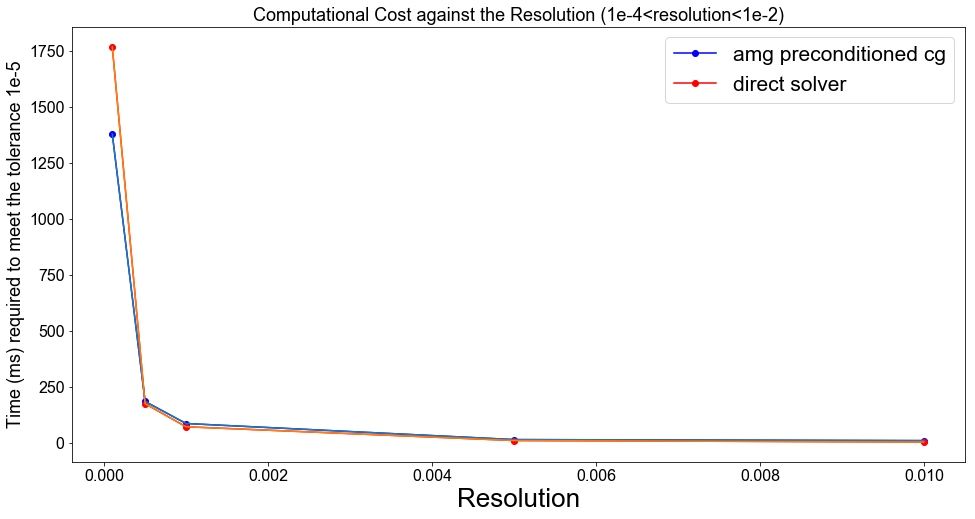

In [6]:
#"""
amg_precond_cg_times=[11.2,15.8,87.5,186,1380]
direct_solver_times=[4.82, 11.5, 73, 176, 1770]
resolution = [1e-2, 5e-3, 1e-3, 5e-4, 1e-4]

fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('Resolution', fontsize=26)
ax1.set_ylabel('Time (ms) required to meet the tolerance 1e-5', fontsize=18)
ax1.set_title('Computational Cost against the Resolution (1e-4<resolution<1e-2)', fontsize=18)
ax1.plot(resolution, amg_precond_cg_times, 'bo-', label='amg preconditioned cg')
ax1.plot(resolution, direct_solver_times, 'ro-', label='direct solver')

ax1.legend(loc='best', fontsize=21)

plt.plot(resolution, amg_precond_cg_times)
plt.plot (resolution, direct_solver_times)
#"""

## Compare CG to Different Krylov Methods (wasn't necessary for Q3 but worth investigating).
Also tested different krylov methods of GMRES and BICGStab to see if CG is indeed better as we expected (CG specifically requires positive definitive matrices and is usually better than GMRES, BICGStab when A is positive definitive). Lets see if this is also true for our case.

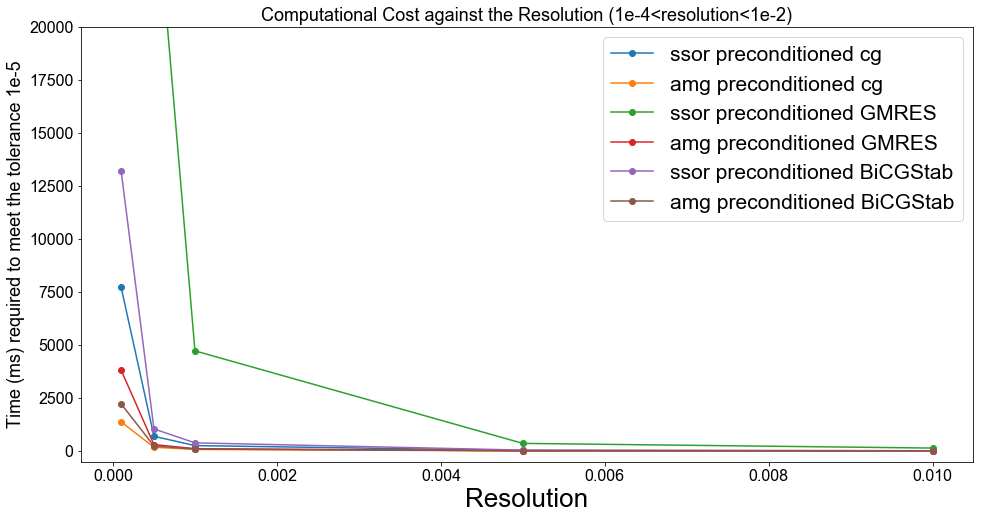

In [7]:
resolution = [1e-2, 5e-3, 1e-3, 5e-4, 1e-4]
# computation times
cg_ssor_time = [16, 35, 264, 703, 7720]
cg_amg_time = [11.1, 14, 82.8, 185, 1380]
GMRES_ssor_time = [147, 368, 4730, 27500, 89100]
GMRES_amg_time = [15.8, 18, 119, 312, 3820]
BICStab_ssor_time = [22.2, 52, 393, 1050, 13200]
BICStab_amg_time = [12.6, 22.2, 101, 244, 2230]

# number of iterations to reach the tolerance of 1e-5.
cg_ssor_it = [16, 35, 264, 703, 7720]
cg_amg_it = [11.1, 14, 82.8, 185, 1380]
GMRES_ssor_it = [147, 368, 4730, 27500, 89100]
GMRES_amg_it = [15.8, 18, 119, 312, 3820]
BICStab_ssor_it = [22.2, 52, 393, 1050, 13200]
BICStab_amg_it = [12.6, 22.2, 101, 244, 2230]

fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('Resolution', fontsize=26)
ax1.set_ylabel('Time (ms) required to meet the tolerance 1e-5', fontsize=18)
ax1.set_title('Computational Cost against the Resolution (1e-4<resolution<1e-2)', fontsize=18)
ax1.plot(resolution, cg_ssor_time, 'o-', label='ssor preconditioned cg')
ax1.plot(resolution, cg_amg_time, 'o-', label='amg preconditioned cg')
ax1.plot(resolution, GMRES_ssor_time, 'o-', label='ssor preconditioned GMRES')
ax1.plot(resolution, GMRES_amg_time, 'o-', label='amg preconditioned GMRES')
ax1.plot(resolution, BICStab_ssor_time, 'o-', label='ssor preconditioned BiCGStab')
ax1.plot(resolution, BICStab_amg_time, 'o-', label='amg preconditioned BiCGStab')
ax1.set_ylim(-500,20000)

ax1.legend(loc='best', fontsize=21)

## Observation

indeed CG works better than GMRES and BICGStab (as expected) especially for high resolution (e.g. < $10^{-4}$).

# ---------------------------------------Q3------------------------------------------------

## Extending to 3D

Based on our observations the best strategy would be to use the amg preconditioned cg method. We observe that increasing the dimentions of A increases computational cost of no-preconditioned cg solver much more than the pre conditioned cg methods. Since the number of grid-points required to solve a 3D problem will be much larger than a 2D problem, the preconditioned cg will be more ideal for 3D problems. Above, we observed that the amg preconditioned CG is the fastest method and, therefore, would be the most ideal for a 3D problem.

# -------------------------------------Q3 End----------------------------------------------

# -----------------------------------1(Part3-Q1-Q3) End----------------------------------

# 2. Solver Configuration for the "Kutta" Finite Element Potential Flow Model (10 points) <a class="tocSkip"></a>
Recommend the most efficient way to solve the second potential flow finite element model, which include circulation and the Kutta condition, implemented in the `KuttaPotentialFlowFE` class from the `potential_flow` module. Again, give the reasons for your choice, and show the analysis you have done to make that decision. This should be based on question 4. in notebook three.

# -----------------------------------2(Part3-Q4)--------------------------------------


## Recommendation

The matrix A is no longer symmetric when the kutta condition is added (so we can no longer use the CG method as it requires A to be symmetric positive definitive). Various Krylov methods (e.g. BICGStab and GMRES) were tested to see which method would solve the second potential flow finite element method. Based on our observations from question 4 below, amg preconditioned BICGStab method is the best method to solve this system.


## Adding the Kutta Condition

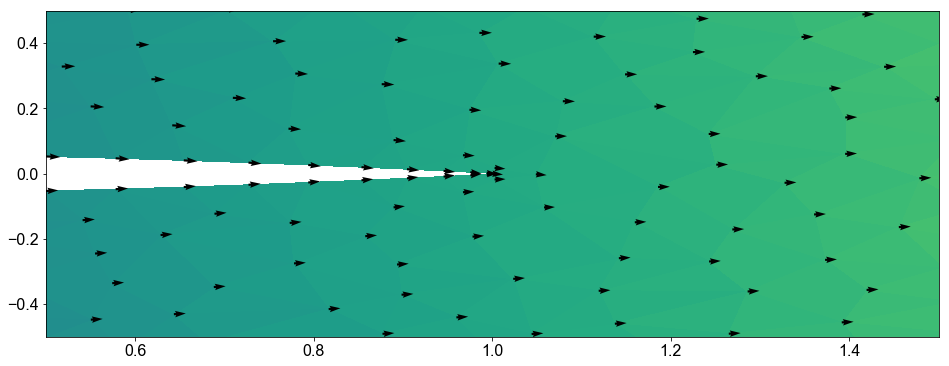

In [8]:
u_inf = 1.
alpha = np.deg2rad(4)
resolution = 1e-2
kpf = KuttaPotentialFlowFE(airfoil, outer_boundary, resolution, u_inf, alpha)

A, b = kpf.assemble()

# solve it
phi = spl.spsolve(A, b)

# and plot the solution:
plt.figure(figsize=(16,6))

kpf.plot_solution(phi)

# we zoom in a little bit, to have a better look at the flow around the airfoil
plt.axis([0.5, 1.5, -0.5, 0.5]);

4. Analyse what the best solver strategy is to solve this linear system. Again consider a range of resolutions. By looking at the properties of the matrix is there a Krylov method that can be excluded from your analysis? 

# ---------------------------------------Q4------------------------------------------------

## check if A is symmetric

In [9]:
#plt.imshow(A);
#shape = np.shape(A);
#print(shape)
#"""
kpf = KuttaPotentialFlowFE(airfoil, outer_boundary, resolution, u_inf, alpha)
A, b = kpf.assemble()
#phi = sl.solve(A, b);
#plt.imshow(A);

symmetric =False
shape = np.shape(A);
print(shape)

# Test if A is Symmetric
A_transpose = A.transpose();
if (np.array_equal(A, A_transpose)):
    print("A is symmetric")
    symmetric =True

else:
    print("A is not symmetric")

#Eigenvalues
eigenvalues, eigenvectors = spl.eigs(A)#sl.eigh(A)
print("min and max eigenvalues of A: ", min(eigenvalues), max(eigenvalues))

if(min(eigenvalues) > 0 ):
    print("eigenvalues are all +ve")
    if(symmetric == True):
        print("Matrix A is +ve definitive")

if(min(eigenvalues) == 0 ):
    print("eigenvalues are all non -ve")
    if(symmetric == True):
        print("Matrix A is +ve semidefinitive")

if(min(eigenvalues) < 0 or symmetric == False):
    print("Matrix A is neither +ve definitive or semi-definitive")
#"""

A, b = kpf.assemble()




(1653, 1653)
A is not symmetric
min and max eigenvalues of A:  (7.544508669341996+0j) (8.026526931448759+0j)
eigenvalues are all +ve
Matrix A is neither +ve definitive or semi-definitive


/Users/tayfunkaraderi/anaconda3/lib/python3.7/site-packages/scipy/sparse/compressed.py:226: SparseEfficiencyWarning: Comparing sparse matrices using == is inefficient, try using != instead.
  " != instead.", SparseEfficiencyWarning)


## Observations
Above, we observe that the matrix A is not symmetric positive definitive and, therefore, we can exclude the CG method from analysis.

## Different strategies to solve this system

In [10]:
#%timeit phi =  spl.cg(A, b, tol=1e-5, callback=counter)
#%timeit phi =  spl.gmres(A, b, tol=1e-5, callback=counter)
#%timeit phi =  spl.bicgstab(A, b, tol=1e-5, callback=counter)
u_inf = 1.
alpha = np.deg2rad(4)
resolution = 5e-2
airfoil = np.loadtxt('naca0012.dat')

kpf = KuttaPotentialFlowFE(airfoil, outer_boundary, resolution, u_inf, alpha)
A, b = kpf.assemble()


jacobi = JacobiPreconditioner(A)
ssor = SSORPreconditioner(A, omega=1.5)
amg = AMGPreconditioner(A)


counter10 = SimpleCounter()
counter11 = SimpleCounter()

counter12 = SimpleCounter()
counter13 = SimpleCounter()

counter14 = SimpleCounter()
counter15 = SimpleCounter()

#%timeit phi1 = spl.cg(A, b, tol=1e-5,callback=counter10, M=ssor)
#%timeit phi2 = spl.cg(A, b, tol=1e-5,callback=counter11, M=amg)

%timeit phi3 = spl.gmres(A, b, tol=1e-5,callback=counter12, M=ssor)
%timeit phi4 = spl.gmres(A, b, tol=1e-5,callback=counter13, M=amg)

%timeit phi5 = spl.bicgstab(A, b, tol=1e-5,callback=counter14, M=ssor)
%timeit phi6 = spl.bicgstab(A, b, tol=1e-5,callback=counter15, M=amg)

9.53 ms ± 25.3 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
9.12 ms ± 40.2 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
9.03 ms ± 1.08 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)
17.9 ms ± 1.06 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [11]:
#print("# of Iterations (cg ssor preconditioning) :", counter10.count)
#print("# of Iterations (cg amg preconditioning) :", counter11.count)

print("# of Iterations (gmres ssor preconditioning) :", counter12.count)
print("# of Iterations (gmres amg preconditioning) :", counter13.count)

print("# of Iterations (bicgstab ssor preconditioning) :", counter14.count)
print("# of Iterations (bicgstab amg preconditioning) :", counter15.count)

# of Iterations (gmres ssor preconditioning) : 72990
# of Iterations (gmres amg preconditioning) : 17842
# of Iterations (bicgstab ssor preconditioning) : 32440
# of Iterations (bicgstab amg preconditioning) : 16220


# Plot of Computational Cost (in ms vs Resolution) for different methods

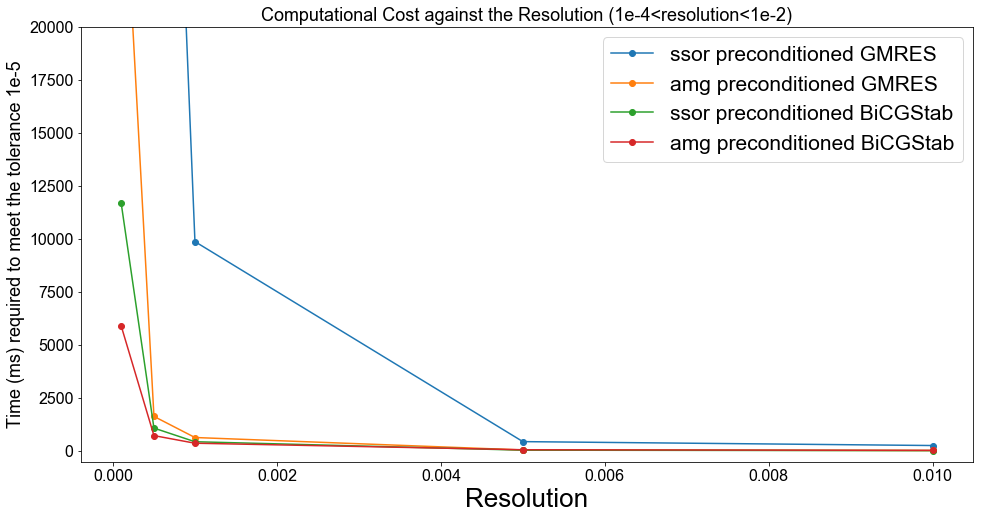

In [12]:
resolution = [1e-2, 5e-3, 1e-3, 5e-4, 1e-4]


GMRES_ssor_time = [267, 451, 9880, 57300, 9910000]
GMRES_amg_time = [33.9, 57.4, 645, 1640, 30100]
BICStab_ssor_time = [25.2, 48, 446, 1090, 11700]
BICStab_amg_time = [38.8, 68.3, 376, 735, 5910]


GMRES_ssor_it = [147, 368, 4730, 27500, 89100]
GMRES_amg_it = [15.8, 18, 119, 312, 3820]
BICStab_ssor_it = [22.2, 52, 393, 1050, 13200]
BICStab_amg_it = [12.6, 22.2, 101, 244, 2230]

fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('Resolution', fontsize=26)
ax1.set_ylabel('Time (ms) required to meet the tolerance 1e-5', fontsize=18)
ax1.set_title('Computational Cost against the Resolution (1e-4<resolution<1e-2)', fontsize=18)
#ax1.plot(resolution, cg_ssor_time, 'o-', label='ssor preconditioned cg')
#ax1.plot(resolution, cg_amg_time, 'o-', label='amg preconditioned cg')
ax1.plot(resolution, GMRES_ssor_time, 'o-', label='ssor preconditioned GMRES')
ax1.plot(resolution, GMRES_amg_time, 'o-', label='amg preconditioned GMRES')
ax1.plot(resolution, BICStab_ssor_time, 'o-', label='ssor preconditioned BiCGStab')
ax1.plot(resolution, BICStab_amg_time, 'o-', label='amg preconditioned BiCGStab')
ax1.set_ylim(-500,20000)

ax1.legend(loc='best', fontsize=21)

#plt.plot(resolution, amg_precond_cg_times)
#plt.plot (resolution, direct_solver_times)

## Observations

From the above plot we see that amg preconditioned BICGStab has the lowest computational cost (both in terms of the convergence time and number of iterations) for all resolutions in the range of (1e-4 to 1e-2). CG was not tested since it requires symmetric positive definitive A which we don't have in this case. 

Based on our observation, amg preconditioned BICGStab method is the best solver strategy to solve this linear system.

# -------------------------------------Q4 End----------------------------------------------

# -----------------------------------2(Part3-Q4) End--------------------------------------



# 3. Solver Configuration for the Panel Method (10 points) <a class="tocSkip"></a>
Recommend the most efficient way to solve the panel method potential flow model implemented in the `PotentialFlowPanelMethod` class. State the reasons for your choice, and show the analysis you have done to make that decision. This should be based on question 5. in notebook three. For this case you may ignore the use of preconditioners.

# -----------------------------------3(Part3-Q5) -------------------------------------------

## Reccomendation

A is not symmetric, not sparse, and has all positive eigenvalues. CG can't be used for this system as it requires A to be symmetric. GMRES and BICGStab without preconditioning was tested to see which method is faster. It was observed that GMRES was the fastest method (see Q5 below). However, this may not be the best of all the methods, one can try many other methods (e.g. spl.cgs, spl.qmr etc.) and observe that another method may work better.

# ---------------------------------------Q5------------------------------------------------


In [13]:
airfoil = np.loadtxt('naca0012.dat')

u_inf = 1.
alpha = np.deg2rad(4)

pfpm = PotentialFlowPanelMethod(airfoil, u_inf, alpha)

A, b = pfpm.assemble()

## check if A is symmetric

In [14]:
#plt.imshow(A);

shape = np.shape(A);
print(shape)

symmetric = False;

# Test if A is Symmetric
A_transpose = A.transpose();
if (np.array_equal(A, A_transpose)):
    print("A is symmetric")
    symmetric =True

else:
    print("A is not symmetric")

#Eigenvalues
eigenvalues, eigenvectors = sl.eigh(A)
print("min and max eigenvalues", min(eigenvalues), max(eigenvalues))

if(min(eigenvalues) > 0 ):
    print("eigenvalues are all +ve")
    if(symmetric == True):
        print("Matrix A is +ve definitive")

if(min(eigenvalues) == 0 ):
    print("eigenvalues are all non -ve")
    if(symmetric == True):
        print("Matrix A is +ve semidefinitive")

if(min(eigenvalues) < 0 ):
    print("Matrix A is neither +ve definitive")

(41, 41)
A is not symmetric
min and max eigenvalues 0.0017129457444058566 2.856836147643077
eigenvalues are all +ve


## Observations
A is not symmetric, not sparse, and has all positive eigenvalues. CG can't be used for this system as it requires A to be symmetric. GMRES and BICGStab without preconditioning will be tested to see which method is faster.

## Solving This System

In [15]:
counter20 = SimpleCounter()
counter21 = SimpleCounter()

%timeit phi3 = spl.gmres(A, b, tol=1e-5,callback=counter20)
%timeit phi5 = spl.bicgstab(A, b, tol=1e-5,callback=counter21) # also could try: spl.cgs, spl.qmr etc.

487 µs ± 54.5 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)
447 µs ± 8.09 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)


In [16]:
print("# of Iterations (cg ssor preconditioning) :", counter20.count)
print("# of Iterations (cg amg preconditioning) :", counter21.count)

# of Iterations (cg ssor preconditioning) : 113554
# of Iterations (cg amg preconditioning) : 72999


## Plot of Computational Cost Against Resolution for Both Methods

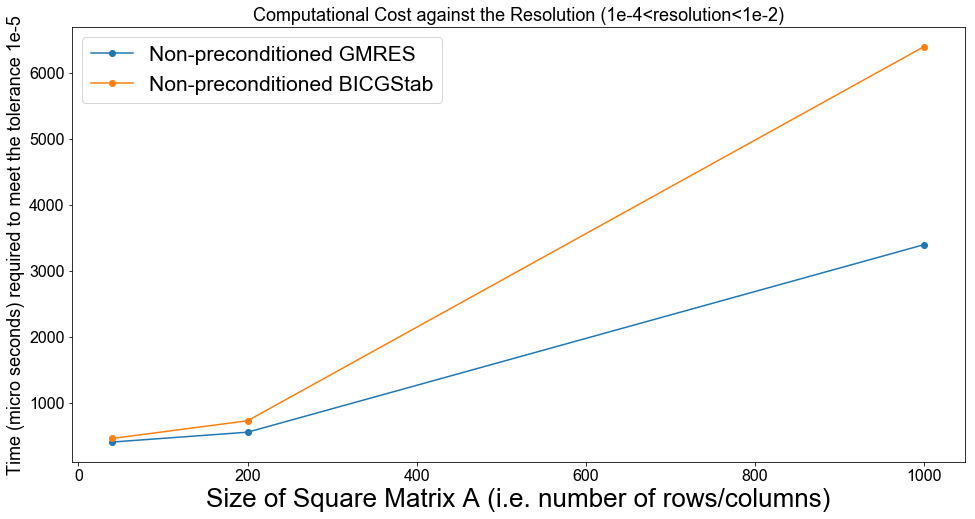

In [17]:
size_of_A = [40, 200, 1000]


GMRES_time = [410, 559, 3400]
BICGStab_time = [464, 732, 6400]



fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('Size of Square Matrix A (i.e. number of rows/columns)', fontsize=26)
ax1.set_ylabel('Time (micro seconds) required to meet the tolerance 1e-5', fontsize=18)
ax1.set_title('Computational Cost against the Resolution (1e-4<resolution<1e-2)', fontsize=18)
ax1.plot(size_of_A, GMRES_time, 'o-', label='Non-preconditioned GMRES')
ax1.plot(size_of_A, BICGStab_time, 'o-', label='Non-preconditioned BICGStab')


#ax1.set_ylim(-500,20000)

ax1.legend(loc='best', fontsize=21)

#plt.plot(resolution, amg_precond_cg_times)
#plt.plot (resolution, direct_solver_times)

## Observations

It was observed that the GMRES method was the fastest iterative solver (for all 3 different resolutions provided by the naca0012.dat, naca0012_200.dat, naca0012_1000.dat files) for this system as displayed by the above plot.

# -------------------------------------Q5 End----------------------------------------------



# -----------------------------------3(Part3-Q5) End--------------------------------------

# 4. Validation of the Potential Flow models (10 points) <a class="tocSkip"></a>
Provide some validation for the lift coefficients predicted by the `KuttaPotentialFlowFE` and `PotentialFlowPanelMethod` models based on question 6. in notebook three.

# -----------------------------------4(Part3-Q6)------------------------------------------

6. Compute the lift coefficient $C_L$ using both `PotentialFlowFE` and `PotentialFlowPanelMethod` for a wide range of angles of attack and compare with the XFOIL results. Plot the results in a graph and draw some conclusions on the accuracy of our two models, and their range of applicability. Also investigate the influence of resolution of both methods on their accuracy.

# ---------------------------------------Q6------------------------------------------------


In [18]:
# polygon describing a NACA0012 airfoil
airfoil = np.loadtxt('naca0012.dat')

## Kutta Potential Flow Method

In [19]:
u_inf = 1.
alpha = np.deg2rad(4)
resolution = 1e-2
kpf = KuttaPotentialFlowFE(airfoil, outer_boundary, resolution, u_inf, alpha)
A, b = kpf.assemble()
# solve it
phi = spl.spsolve(A, b)

## Potential Flow Panel Method

In [20]:
u_inf = 1.
alpha = np.deg2rad(4)
pfpm = PotentialFlowPanelMethod(airfoil, u_inf, alpha)

A, b = pfpm.assemble()
sigma = sl.solve(A, b)

## Compute the Lift Coefficients For Various Angle of Attacks

In [21]:
#Lift from PotentialFlowFE
#print(pf.lift_coeffcient(phi_PFFE))

angle_of_attack = np.arange(-19.25, 19.3, 0.25)

#Lift from KuttaPotentialFlowFE
#----------
KPF_Cl = []
for i in angle_of_attack:
    u_inf = 1.
    alpha = np.deg2rad(i)
    resolution = 1e-2
    kpf = KuttaPotentialFlowFE(airfoil, outer_boundary, resolution, u_inf, alpha)
    A, b = kpf.assemble()
    # solve it
    phi = spl.spsolve(A, b)
    #print("kpf lift = ", kpf.lift_coeffcient(phi))
    KPF_Cl.append(kpf.lift_coeffcient(phi))
#----------

#Lift from PotentialFlowPanelMethod
#----------
PFPM_Cl = []
for i in angle_of_attack:
    airfoil = np.loadtxt('naca0012.dat')

    u_inf = 1.
    alpha = np.deg2rad(i)

    pfpm = PotentialFlowPanelMethod(airfoil, u_inf, alpha)
    A, b = pfpm.assemble()
    sigma = sl.solve(A, b)
    #print("pfpm lift = ", pfpm.lift_coeffcient(sigma))
    PFPM_Cl.append(pfpm.lift_coeffcient(sigma))

#----------


#print(pfpm.lift_coeffcient(sigma))

## Read the $C_l$ from xf-n0012-il-1000000-n5.csv

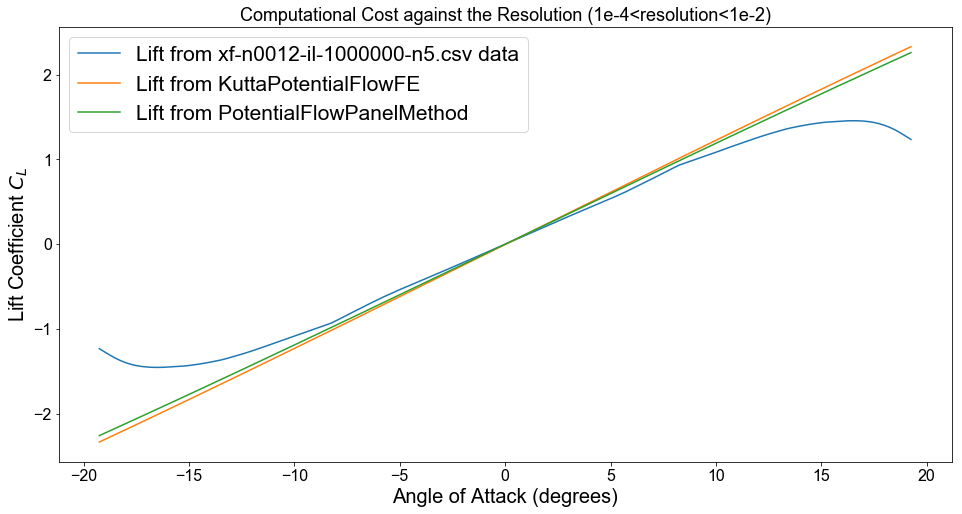

In [22]:
angle = np.loadtxt("xf-n0012-il-1000000-n5.csv",delimiter=',',skiprows=11, usecols=(0))
Cl = np.loadtxt("xf-n0012-il-1000000-n5.csv",delimiter=',',skiprows=11, usecols=(1))

fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('Angle of Attack (degrees)', fontsize=20)
ax1.set_ylabel('Lift Coefficient $C_L$', fontsize=20)
ax1.set_title('Computational Cost against the Resolution (1e-4<resolution<1e-2)', fontsize=18)
ax1.plot(angle, Cl, '-', label='Lift from xf-n0012-il-1000000-n5.csv data')
ax1.plot(angle_of_attack, KPF_Cl, '-', label='Lift from KuttaPotentialFlowFE')
ax1.plot(angle_of_attack, PFPM_Cl, '-', label='Lift from PotentialFlowPanelMethod')

ax1.legend(loc='best', fontsize=21)


## Observations

From the above plot it can be seen that our methods KuttaPotentiaFlowFE and PotentialFlowPanel methods are accurate for small angles of attack (e.g. -5 to 5 degrees) and for large angles it gets less and less accurate. This is because we cannot incorporate flow separation which occurs at higher angles of attack, due to our inability to model viscous effects and thus boundary layers.

## Resolution

Resolution is varied for an angle of attack of 4 degrees and the error (calculated as the absolute difference between the $C_L$ values calculated by KuttaPotentialFlowFE and PotentialFlowPanelMethod methods and the exact $C_L$ value from the xf-n0012-il-1000000-n5.csv data) is plotted against the resolution.

In [23]:
Resolution = [0.00001, 0.00005, 0.0001, 0.0002, 0.002, 0.05, 0.075, 0.1, 0.125, 0.15, 0.175, 0.2]

#Lift from KuttaPotentialFlowFE
#----------
KPF_Cl2 = []
for i in Resolution:
    u_inf = 1.
    alpha = np.deg2rad(4)
    resolution = i
    kpf = KuttaPotentialFlowFE(airfoil, outer_boundary, resolution, u_inf, alpha)
    A, b = kpf.assemble()
    # solve it
    phi = spl.spsolve(A, b)
    #print("kpf lift = ", kpf.lift_coeffcient(phi))
    KPF_Cl2.append(kpf.lift_coeffcient(phi))
#----------



#""" 
#Lift from PotentialFlowPanelMethod
#----------
Resolution2 = ["naca0012.dat", "naca0012_200.dat", "naca0012_1000.dat"]
PFPM_Cl2 = []
for i in Resolution2:
    print(i)
    airfoil = np.loadtxt(i)

    u_inf = 1.
    alpha = np.deg2rad(4)

    pfpm = PotentialFlowPanelMethod(airfoil, u_inf, alpha)
    A, b = pfpm.assemble()
    sigma = sl.solve(A, b)
    #print("pfpm lift = ", pfpm.lift_coeffcient(sigma))
    PFPM_Cl2.append(pfpm.lift_coeffcient(sigma))

#----------
#"""

naca0012.dat
naca0012_200.dat
naca0012_1000.dat


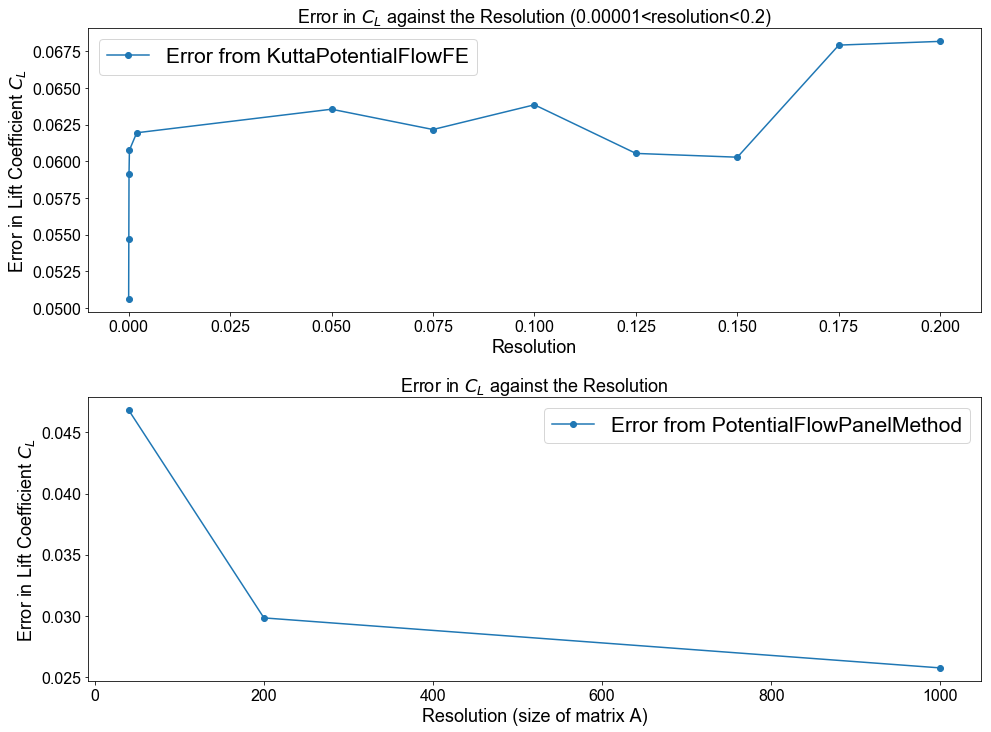

In [24]:
# lift ($C_L$) from xf-n0012-il-1000000-n5.csv 
lift_exact = Cl[91]
# Error (difference between the exact and KuttaPotentialFlowFE lift)
Error = abs(KPF_Cl2-lift_exact)
# Error2 (difference between the exact and PotentialFlowPanelMethod lift)
Error2 = abs(PFPM_Cl2-lift_exact)



# Plot Error against resolution

fig = plt.figure(figsize=(16, 12))
ax1 = fig.add_subplot(211)
ax1.set_xlabel('Resolution', fontsize=18)
ax1.set_ylabel('Error in Lift Coefficient $C_L$', fontsize=18)
ax1.set_title('Error in $C_L$ against the Resolution (0.00001<resolution<0.2)', fontsize=18)
ax1.plot(Resolution, Error, 'o-', label='Error from KuttaPotentialFlowFE')
ax2 = fig.add_subplot(212)
size_of_A = [40, 200, 1000]
ax2.set_xlabel('Resolution (size of matrix A)', fontsize=18)
ax2.set_ylabel('Error in Lift Coefficient $C_L$', fontsize=18)
ax2.set_title('Error in $C_L$ against the Resolution', fontsize=18)
ax2.plot(size_of_A, Error2, 'o-', label='Error from PotentialFlowPanelMethod')

ax1.legend(loc='best', fontsize=21)
ax2.legend(loc='best', fontsize=21)


fig.subplots_adjust(wspace=0, hspace=0.3)


## Observations

From the above plots we see that increasing the resolution generally deacreases the error up to a point but the error doesn't seem to approach to 0 for the KuttaPotentaialFE method. A similar trend is also seen for PotentialFlowPanelMethod however, the resolution can't be increased further to test whether error approaches 0. However, the expectation is that the error will not approach to 0 due to modelling errors (incompressible flow, no viscous effects etc).

# -------------------------------------Q6 End----------------------------------------------

# -----------------------------------4(Part3-Q6) END-------------------------------------

## Items based on notebook two: <a class="tocSkip"></a>

# 5. Shape Factor and Its Derivative (10 points) <a class="tocSkip"></a>
Implementation of the derivative of the `shape_factor` function described in notebook two. You should include the test results for the function and any components it uses. Question 1. to 4. of notebook two.

# 6. Experiments with Optimisation Based on Shape Factor (10 points) <a class="tocSkip"></a>
Simply copy and describe your answers to questions 5. to 8. of notebook two. **NOTE**: In question 6. you were asked to include the `newton-cg` method, the intention was to show that this method, a pure Newton method, is not very efficient as it needs to approximate the Hessian by evaluating the Jacobian many times. However it turns out that the method for approximating the Hessian is not very reliable either, often causing the optimisation to not converge at all. If this is what you find, simply state these observations in your report.

# -----------------------------------5(Part2-Q1-Q4)---------------------------------------

1. Given the analytical formulae for the perimeter and area of a regular polygon below, test the `area` and `length` functions by comparing the analytical result with the result of the functions for a range of $n$, the number of edges.

\begin{align*}
  p &= 2 n R \sin(\frac{\pi}{n}) \\
  A &= \tfrac 12 nR^2\sin(\frac{2\pi}n)
\end{align*}

2. Write a function `grad_area` that takes a vector $\vec x\in\R^{(n+1)\times 2}$ (describing a polygon) and returns the derivative of its area with respect to $\vec x$.  The returned derivative should be a $(n+1,2)$ rank-2 array. Test this derivative function using the Taylor test.

**Hint**: Looking at the `area` function, we see that the area is computed as:

$$
  A = \sum_i A_i,\;\;\text{where}\;
  A_i = \tfrac 12\left(x_{i,0}-x_{i+1,0}\right)\left(x_{i,1}+x_{i+1,1}\right)
$$

based on the explanation for `grad_length`, we can use the following structure

```python
def grad_area(x):
    """Compute the gradient of area(x)."""
    n = len(x)-1
    dadx = np.zeros((n+1, 2))
    for i in range(n):
        dadx[i, 0] += ... # derivative of A_i w.r.t x_{i,0}
        dadx[i+1, 0] += ... # derivative of A_i w.r.t x_{i+1,0}
        dadx[i, 1] += ... # derivative of A_i w.r.t x_{i,1}
        dadx[i+1, 1] += ... # derivative of A_i w.r.t x_{i+1,1}

    return dadx
```

3. If you compare the exact convergence numbers of `grad_area` with those of `grad_length` what do you notice? Can you think of a reason why (what mathematical property of the `area` function causes this) ?

4. Write a function `grad_shape_factor` that computes the derivative of `shape_factor` and test it with the Taylor test.

## required functions and imports for notebook 2

In [25]:
# needs to be in separate cell!
%matplotlib inline

In [26]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.linalg as sl
import scipy.optimize as sop
from mpltools import annotation  # draws triangles in convergence plots
plt.rcParams['font.size'] = 16
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial', 'Dejavu Sans']

In [27]:
def regular_polygon(R, n):
    """Create a regular polygon of radius R with n sides"""
    alpha = 2*np.pi/n
    x = []
    for i in range(n+1):
        x.append([R*np.cos(alpha*i), R*np.sin(alpha*i)])
    return np.array(x)   
def area(x):
    """Compute the area of the polygon x"""
    n = len(x)-1
    a = 0.
    for i in range(n):
        a += (x[i,0]-x[i+1,0])*(x[i,1]+x[i+1,1])/2.
    return a

def length(x):
    """Compute the length of the path described by the list of points x."""
    n = len(x)-1
    l = 0.
    for i in range(n):
        l += sl.norm(x[i+1]-x[i])
    return l

def grad_length(x):
    """Compute the gradient of length(x)."""
    n = len(x)-1
    dldx = np.zeros((n+1, 2))
    for i in range(n):
        dldx[i, 0] += -(x[i+1,0]-x[i,0])/sl.norm(x[i+1]-x[i])
        dldx[i+1, 0] += (x[i+1,0]-x[i,0])/sl.norm(x[i+1]-x[i])
        dldx[i, 1] += -(x[i+1,1]-x[i,1])/sl.norm(x[i+1]-x[i])
        dldx[i+1, 1] += (x[i+1,1]-x[i,1])/sl.norm(x[i+1]-x[i])
    return dldx

def shape_factor(x):
    """Computes the ratio l/sqrt{A}"""
    return length(x)/np.sqrt(area(x))

def taylor_test(f, grad_f, x, h0, max_iter=20, plot_convergence=True, print_convergence=True):
    """Taylor test to verify that the function grad_f is the derivative of the function `f`
    
    We test:
    
       f(x + h) = f(x) + grad_f(x).h + O(h^2)
    
    f, grad_f  - function and its derivative to test
    x          - point in which to test
    h0         - initial perturbation
    max_iter   - number of times that h is halved
    plot_convergence - whether to plot the convergence of the Taylor residual f(x+h)-f(x)-grad_f(x).h
    print_convergence - prints the order of convergence between subsequent iterations."""


    h = h0.copy()
    residuals = []
    hnorms = []
    for i in range(max_iter):
        r = f(x + h) - f(x) - np.sum(grad_f(x) * h)
        residuals.append(sl.norm(r))
        hnorms.append(sl.norm(h))
        h /= 2.

    if plot_convergence:
        fig, ax = plt.subplots(1,2, figsize=(16,4))
        ax[0].semilogy(residuals)
        ax[0].set_xlabel('iteration')
        ax[0].set_ylabel('Taylor residual $|r|$')
        ax[0].set_xticks(range(0,max_iter,2))
        ax[1].loglog(hnorms, residuals)
        ax[1].set_xlabel('perturbation size $\|h\|$')
        ax[1].set_ylabel('Taylor residual $|r|$')

        # NOTE: slope_marker does not seem to work in semilogy plots
        annotation.slope_marker((1e-3, 1e-4), (2, 1), invert=True, ax=ax[1], size_frac=.2)

    if print_convergence:
        residuals = np.array(residuals)
        print('Order of convergence, log(r(h_i)/r(h_{i+1}))/log(2):')
        print(np.log(residuals[:-1]/residuals[1:])/np.log(2))
    
    
    
class ShapeOptimisationProblem:
    """Shape optimisation based on a polygon.
    
    The first and last vertex of this polygon, described a list of vertices
    should be the same and will not be changed during the optimisation."""
    def __init__(self, x0, f_user, grad_f_user, store_function_evaluations=True, store_gradient_evaluations=True):
        """
        x0     - the initial polygon of n edges, described by a shape (n+1,2) array of vertex positions,
                 where the first and last vertex should be the same to describe a closed polygon
        f_user      - the function that computes the objective values, should take a shape (n+1,2) array
        grad_f_user - function that computes the gradient of f, should take and return a shape (n+1,2) array
        store_function_evaluations, store_gradient_evaluations - if either set to true, self.x_i stores
                                                                 a list of (n+1,2) arrays representing
                                                                 the polygons for which the function or 
                                                                 gradient was evaluated."""        
        self.f_user = f_user
        self.grad_f_user = grad_f_user
        self.x0 = x0.copy()  # we keep a copy of the original polygon
        self.x = x0.copy()  # this is the copy we are actually going to change
        self.n = len(x0)-1
        self.x_i = []  # stores subsequent iterations when asked for
        self.store_function_evaluations = store_function_evaluations
        self.store_gradient_evaluations = store_gradient_evaluations
        
    def minimize(self, *args, **kwargs):
        """Wrapper around scipy.optimize.minimize
        
        Passes the correct function, gradient and initial guess. Any further arguments are also passed on
        to scipy's minimie"""
        # make a copy of x0, so that if we call minimize() again
        # we again start from the same initial guess provided in __init__()
        self.x = self.x0.copy()
        # now turn that into a flat vector
        x0_vec = self.get_x_vec()
        return sop.minimize(self.f, x0_vec, jac=self.jac, *args, **kwargs)
        
    def set_x(self, x_vec):
        """Set self.x based on the 2(n-1) vector used by scipy minimize"""
        # copy into self.x, leaving first and last vertex unchanged:
        self.x[1:self.n, :] = x_vec.reshape((self.n-1, 2))
        
    def get_x_vec(self):
        """Obtain the 2(n-1) vector from self.x"""
        return self.x[1:self.n,:].flatten()  # skip first and last vertex, and flatten
                
    def f(self, x_vec):
        """Wrapper function f, called by scipy's minimize"""
        self.set_x(x_vec)
        if self.store_function_evaluations:
            self.x_i.append(self.x.copy())
        f = self.f_user(self.x)
        return f
    
    def jac(self, x_vec):
        """Wrapper gradient function, called by scipy's minimize"""
        self.set_x(x_vec)
        if self.store_gradient_evaluations:
            self.x_i.append(self.x.copy())
        grad = self.grad_f_user(self.x)
        return grad[1:self.n,:].flatten()  # skip gradient associated with first and last vertex

# -----------------------------------------Q1----------------------------------------------

1. Given the analytical formulae for the perimeter and area of a regular polygon below, test the `area` and `length` functions by comparing the analytical result with the result of the functions for a range of $n$, the number of edges.

\begin{align*}
  p &= 2 n R \sin(\frac{\pi}{n}) \\
  A &= \tfrac 12 nR^2\sin(\frac{2\pi}n)
\end{align*}

In [28]:
#funtions to compute the analytic area and perimeter of the polygons
def analytic_perimeter(R, n):
    p = 2*n*R*np.sin(np.pi/n)
    return (p)

def analytic_area(R, n):
    A = 0.5*n*R*R*np.sin((2*np.pi)/n)
    return (A)

In [29]:
#Polygon test cases
x_test1 = regular_polygon(1, 8)
x_test2 = regular_polygon(2.8, 6)


# area and perimeter for test1 as computed with the above functions
p_test1 = length(x_test1)
A_test1 = area(x_test1)
# analytic
p_analytic_test1 = analytic_perimeter(1, 8)
A_analytic_test1 = analytic_area(1, 8)

# area and perimeter for test2 as computed with the above functions
p_test2 = length(x_test2)
A_test2 = area(x_test2)
# analytic
p_analytic_test2 = analytic_perimeter(2.8, 6)
A_analytic_test2 = analytic_area(2.8, 6)

# test that both the analytic_perimeter and the analytic area functions give the same output
def test_A_p_functions(length, Area, analytic_perimeter, analytic_Area):
    if ((length <= 1.00001 *analytic_perimeter or length >= 0.99999 *analytic_perimeter) and (Area <= 1.00001*analytic_Area or Area >= 0.99999*analytic_Area)):
        print("test passed: area and perimeter computed is the same (to 5 sf) as the analytical")
        return True
    else:
        print("test failed: area and perimeter computed are not the same (to 5 sf) as the analytical")
        return False

#Now lets test
test_A_p_functions(p_test1, A_test1, p_analytic_test1, A_analytic_test1)
test_A_p_functions(p_test2, A_test2, p_analytic_test2, A_analytic_test2)

test passed: area and perimeter computed is the same (to 5 sf) as the analytical
test passed: area and perimeter computed is the same (to 5 sf) as the analytical


True

# Observations from testing

We see that area and length functions compute the same area and perimeter within a tolerance, however, sometimes there are floating point errors.

# ---------------------------------------Q1-End--------------------------------------------

# -----------------------------------------Q2----------------------------------------------

In [30]:
def grad_area(x):
    """Compute the gradient of area(x)."""
    n = len(x)-1
    dadx = np.zeros((n+1, 2))
    for i in range(n):
        dadx[i, 0] += 0.5*(x[i,1]+x[i+1,1])
        dadx[i+1, 0] += -0.5*(x[i,1]+x[i+1,1])
        dadx[i, 1] += 0.5*(x[i,0]-x[i+1,0])
        dadx[i+1, 1] += 0.5*(x[i,0]-x[i+1,0])
    return dadx

# ---------------------------------------Q2-End--------------------------------------------

# -----------------------------------------Q3----------------------------------------------

## Taylor Test

Order of convergence, log(r(h_i)/r(h_{i+1}))/log(2):
[2.         2.         2.         2.         2.         2.
 2.         2.         2.         2.00000002 2.00000013 2.00000059
 1.99999952 2.00001232 2.0000087  2.00008112 2.00033222 1.99998465
 1.9931868 ]


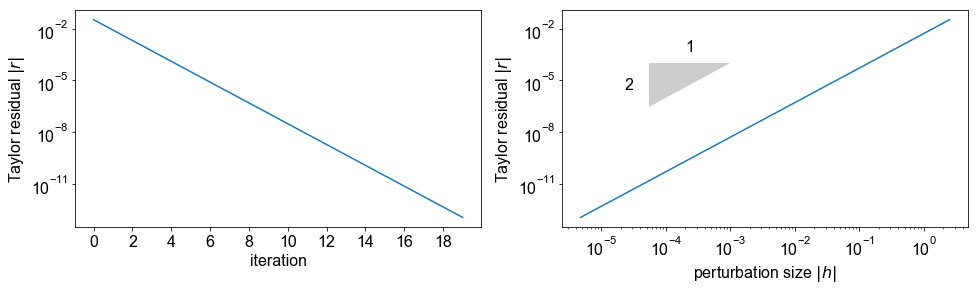

In [31]:
# we test the derivative around a regular polygon
R = 1.5
n = 6
x = regular_polygon(R, n)

# our original perturbation h0 is chosen as a random vector
# with values between 0 and 1
np.random.seed(0)  #  (* see note 2 below)
h0 = np.random.random((n+1, 2))

taylor_test(area, grad_area, x, h0)

## Observations

order of convergence is the same in both area and length.

# ---------------------------------------Q3-End--------------------------------------------

# ---------------------------------------Q4-------------------------------------------------

In [32]:
# derivative of the shape factor. dQ/dx = (2*A*l' - l*A')/(2*A^3/2)
def grad_shape_factor(x):
    numerator_term1 = 2*area(x)*grad_length(x) # 2*A*dL/dx
    numerator_term2 = length(x) * grad_area(x) # L*d/dx(A)
    dQdx =  (numerator_term1 - numerator_term2)/(2*(area(x))**(3/2)) # using the quotient rule
    return dQdx

# ------------------------------------taylor test--------------------------------------------

Order of convergence, log(r(h_i)/r(h_{i+1}))/log(2):
[1.90711954 1.94745542 1.97201987 1.98554933 1.9926543  1.99629633
 1.99814036 1.99906822 1.99953362 1.9997667  1.99988332 1.99994181
 1.99997131 1.99998454 1.99999362 1.99998724 2.00003992 1.99903316
 1.99702373]


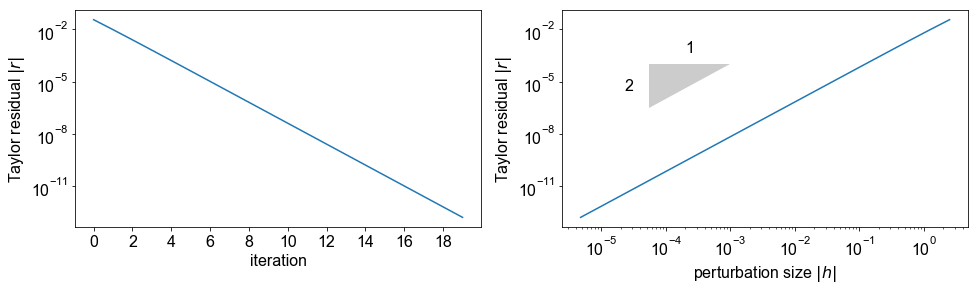

In [33]:
taylor_test(shape_factor, grad_shape_factor, x, h0)

## Observations

The order of convergence is 2 as expected.

# --------------------------------------Q4 End---------------------------------------------

# -----------------------------------5(Part2-Q1-Q4) End----------------------------------

# -----------------------------------6(Part2-Q5-Q8)---------------------------------------

5. You have probably guessed by now what the optimal shape is that minimizes $Q=l/\sqrt{A}$. If not, run the optimisation for a little longer and see what you get. Derive an analytical expression for the minimal value of $Q$ that you expect based on this, and compare with what the optimisation achieves as a minimal value for $Q$

6. Although Newton's method requires second derivative information (the Hessian), the `newton-cg` method of `minimize` can be used without providing a Hessian function. If this function is not provided it will  numerically approximate the Hessian by evaluating `jac` and studying its variation when perturbed in different directions, i.e.
$$
  f''(\vec x)\vec h \approx \frac{f'(\vec x+ \vec h) - f'(\vec x)}{\|\vec h\|}
$$
for small vectors $\vec h$ in different directions. Compare the performance of `newton-cg` and `bfgs` in terms of how much time it takes to achieve a certain error and explain the difference (have a close look at the `result` object). Plot the results in a graph with computation time on the $x$-axis vs. error (difference between exact minimum and achieved function value) on the $y$-axis, based on a number of runs with a different number of iterations. You may also include other methods supported by `minimize` (e.g. CG) that are appropriate. For a more "challenging" initial guess you could use the `uk1.dat` and `uk2.dat` (higher resolution) polygons instead of the naca0012.

7. As was mentioned in the lecture, for quasi-Newton secant methods, such as BFGS, the initial scaling is important. This is because when the method starts out, and the Hessian is only poorly approximated, the method is close to Steepest Descent. Try to scale the function by a constant factor (for instance $0.1$) and see if you observe a difference. Since the cost per iteration will be the same, in this case you can simply compare the number of iterations it takes to reach a certain value of $Q$ (iterations it takes to have an error smaller than say 0.05).

8. Test that `grad_shape_factor_ar` is the correct derivative of `shape_factor_ar`, and use these two functions to perform an actual optimisation that transforms the NACA0012 airfoil into the ellipse shown above with an aspect ratio of 10.

# ---------------------------------------Q5------------------------------------------------

The shape that minimizes $Q=l/\sqrt{A}$ is a circle. the minimal value of Q based on this is $2\sqrt{\pi} = 3.544907702 $ (to 10 s.f) . The final value of Q after 1000 iterations was 3.548559298075943 (using method='bfgs') which is very close to the analytic value and it was also observed that as the number of iterations were increased the value of Q was approaching to that of the analytical.. 

# -------------------------------------Q5 End----------------------------------------------

# ---------------------------------------Q6------------------------------------------------

In [34]:
x0 = np.loadtxt('naca0012.dat')
so = ShapeOptimisationProblem(x0, shape_factor, grad_shape_factor)

# with a loose tolerance, we may not need all 100 iterations to achieve the stopping criterion
result1 = so.minimize(method='bfgs', options={'maxiter':10000}, tol=1e-5)
print('With tol=0.00001, bfgs stopped after {} iterations with message: {}'.format(result1['nit'], result1['message']))

# with a loose tolerance, we may not need all 100 iterations to achieve the stopping criterion
result2 = so.minimize(method='newton-cg', options={'maxiter':10000}, tol=1e-5)
print('With tol=0.00001, newton-cg stopped after {} iterations with message: {}'.format(result2['nit'], result2['message']))

With tol=0.00001, bfgs stopped after 501 iterations with message: Optimization terminated successfully.
With tol=0.00001, newton-cg stopped after 10 iterations with message: Warning: CG iterations didn't converge.  The Hessian is not positive definite.


## Observations
The expectation was that the newton cg method would take more time per iteration since it also approximates the Hessian by evaluating the Jacobian many times, and, thus, would take more time to converge. However, the method for approximating the Hessian with the newton-cg method is not very reliable either and therefore CG iterations did not converge with a warning message that the Hessian is not positive definitive. The graph comparing convergence time against the tolerance could not be produced since cg method doesnt converge for almost any tolerance number.

# -------------------------------------Q6 End----------------------------------------------

# ---------------------------------------Q7------------------------------------------------

In [35]:
# Shape factor function scaled by the constant C
def shape_factor2(x):
    """Computes the ratio l/sqrt{A}"""
    return C*length(x)/np.sqrt(area(x))

# derivative of the shape factor function scaled by the constant C.
def grad_shape_factor2(x):
    numerator_term1 = 2*area(x)*grad_length(x) # 2*A*dL/dx
    numerator_term2 = length(x) * grad_area(x) # L*d/dx(A)
    dQdx =  (numerator_term1 - numerator_term2)/(2*(area(x))**(3/2)) # using the quotient rule
    return C*dQdx

# Number of iterations until the tolerance criteria is met
niterations=[]
# scale the function by a scaling factor C
for C in [0.01, 0.1, 0.5, 1., 10., 30, 50., 75, 100.]:
    so = ShapeOptimisationProblem(x0, shape_factor2, grad_shape_factor2)
    result1 = so.minimize(method='bfgs', options={'maxiter':10000}, tol=1e-3)
    niterations.append(result1['nit'])

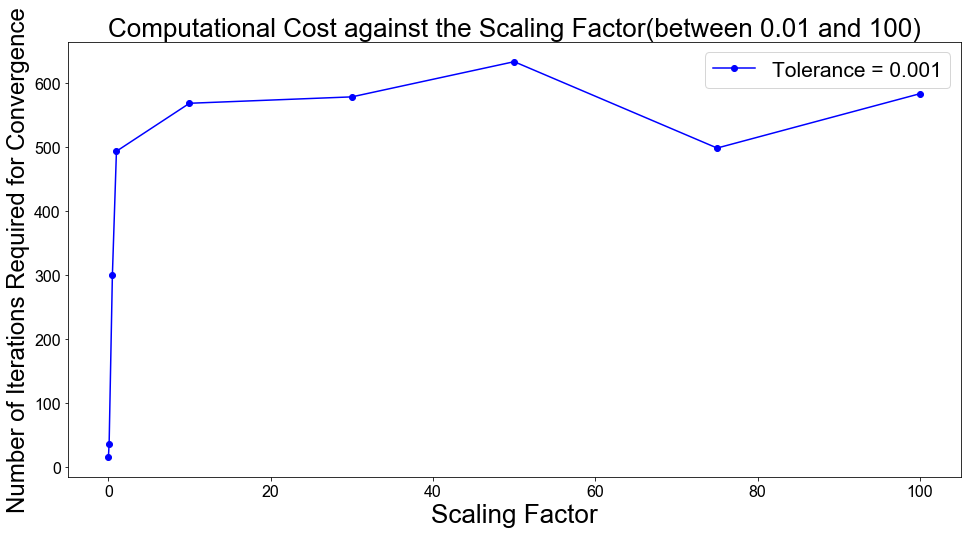

In [36]:
C = [0.01, 0.1, 0.5, 1., 10., 30, 50., 75, 100.]
niterations

fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('Scaling Factor', fontsize=26)
ax1.set_ylabel('Number of Iterations Required for Convergence', fontsize=24)
ax1.set_title('Computational Cost against the Scaling Factor(between 0.01 and 100)', fontsize=26)
ax1.plot(C, niterations, 'bo-', label='Tolerance = 0.001')

ax1.legend(loc='best', fontsize=21)



## Observations

In the above plot it can be seen that changing the scaling factor influences the computational cost significantly. The general trend for our function seems to be that using smaller scalling factor generally improves the computational cost (e.g. lowest number of iterations above was 16 for C=0.01 and highest was 584 iterations for C=100).

# -------------------------------------Q7 End----------------------------------------------


# Aspect Ratio
Of course optimal airfoils are not circular, there are other properties of an airfoil we want to optimize for. In the next part of this coursework, we will look at how to compute lift, the upwards force the flow exerts on the airfoil. Optimising for lift only however, gives rise to some very unphysical solutions. To avoid those, we can add a regularisation term in the objective function that penalizes a solution if it deviates too much from what we think of as a feasible solution. It turns out that the function $Q=l/\sqrt{A}$ that we have studied works very well as a regularisation term. Everything we have derived in this notebook will therefore be needed in the final optimisation.

Again, the cross section of a reasonable airfoil is not a circle. An ellipse with the right aspect ratio however, already looks a lot more like a "natural" airfoil, where the aspect ratio of the ellipse represents the ratio between the front-to-tip length and the thickness of the airfoil.

Area ellipse: 0.07821723252011542
Area NACA0012: 0.08184061082310393


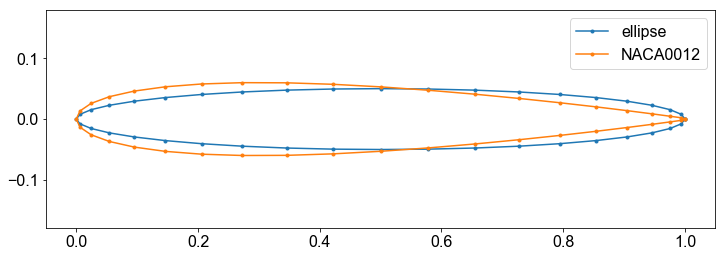

In [37]:
aspect_ratio = 10  # length of 1, and thickness of 0.1
x1 = regular_polygon(0.5, 40)
x1[:,0] += 0.5
x1[:,1] /= aspect_ratio

x2 = np.loadtxt('naca0012.dat')
plt.figure(figsize=(12,4))
plt.plot(x1[:, 0], x1[:, 1], '.-', label='ellipse')
plt.plot(x2[:, 0], x2[:, 1], '.-', label='NACA0012')
plt.legend()
plt.axis('equal')

print('Area ellipse:', area(x1))
print('Area NACA0012:', area(x2))

We can change our function `shape_factor` by scaling the $y$ coordinates of the vertices before the computation. If we multiply the $y$ coordinates by the aspect ratio, then an ellipse like the above is transformed to a circle, and thus this ellipse will have a minimal value returned by `shape_factor`. For this we introduce new versions of `shape_factor` and `grad_shape_factor`:

In [38]:
aspect_ratio = 10.0

def shape_factor_ar(x):
    x[:,1] *= aspect_ratio  # scale y-coordinates: ellipse -> circle
    Q = shape_factor(x)
    x[:,1] /= aspect_ratio   # change back y-coords
    return Q

def grad_shape_factor_ar(x):
    x[:,1] *= aspect_ratio  # scale y coordinates: ellipse -> circle
    dQdx = grad_shape_factor(x)
    x[:,1] /= aspect_ratio  # change back y-coords
    # also rescale the y-derivatives:
    dQdx[:,1] *= aspect_ratio
    return dQdx

Note that we scale the $y$ coordinates back again before exiting the functions, so that we don't mess up any calculations outside of it. In the case of the derivative, `grad_shape_factor_ar` we also need to rescale the "$y$"-derivatives.

That brings us to the final assignment of this notebook:

# ---------------------------------------Q8------------------------------------------------

8. Test that `grad_shape_factor_ar` is the correct derivative of `shape_factor_ar`, and use these two functions to perform an actual optimisation that transforms the NACA0012 airfoil into the ellipse shown above with an aspect ratio of 10.

## Test that grad_shape_factor_ar is the correct derivative using the taylor test

Order of convergence, log(r(h_i)/r(h_{i+1}))/log(2):
[1.85134292 1.95637767 1.98904341 1.99738701 1.99940419 1.99987749
 1.99998222 2.00000193 2.00000366 2.0000025  2.00000139 2.00000089
 2.00000069 1.99999994 1.999986   1.99996738 1.99995325 2.00027653
 2.00084941]


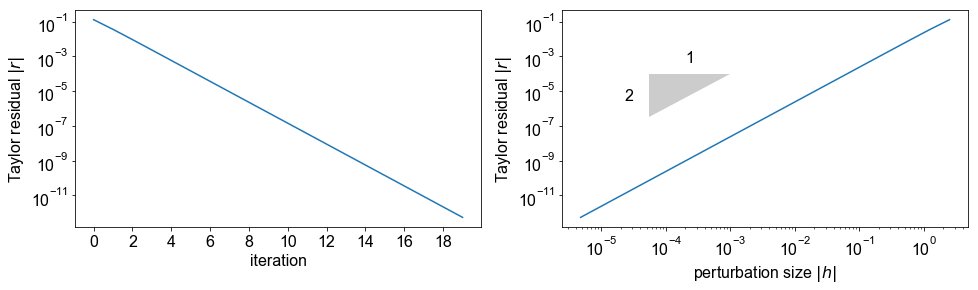

In [39]:
# we test the derivative around a regular polygon
R = 1.5
n = 6
x = regular_polygon(R, n)

# our original perturbation h0 is chosen as a random vector
# with values between 0 and 1
np.random.seed(0)  #  (* see note 2 below)
h0 = np.random.random((n+1, 2))
taylor_test(shape_factor_ar, grad_shape_factor_ar, x, h0)

## Observations
We observe that the order of convergence, computed from subsequent iterations, rapidly reaches the expected value of 2.

## The Actual optimisation

In [40]:
aspect_ratio = 10.0
x0 = np.loadtxt('naca0012.dat')
so = ShapeOptimisationProblem(x0, shape_factor_ar, grad_shape_factor_ar)
result = so.minimize(method='bfgs', options={'maxiter': 200})

## Let's Plot the Airfoil Configurations

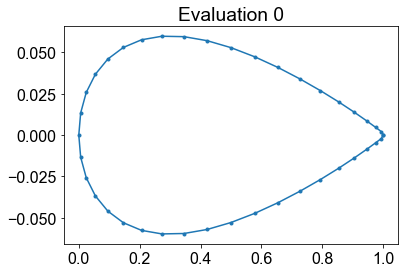

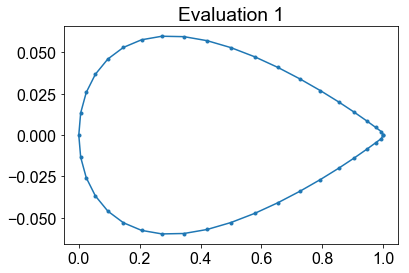

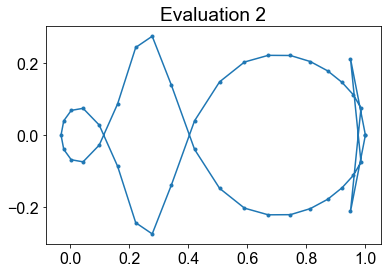

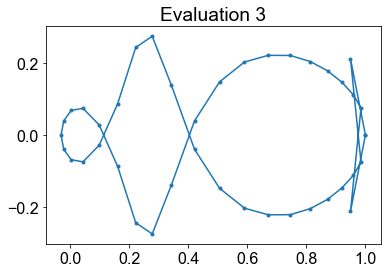

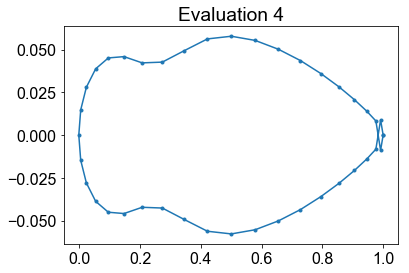

...

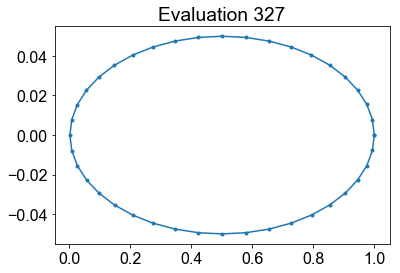

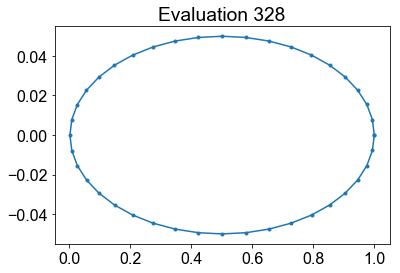

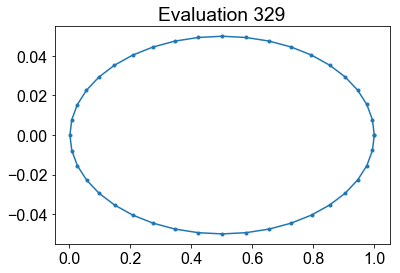

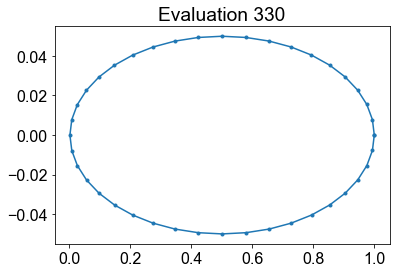

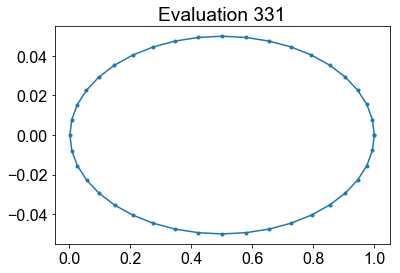

In [41]:
final_function_values = []
for i, x in enumerate(so.x_i):
    plt.plot(x[:,0], x[:,1], '.-')
    print()
    plt.title('Evaluation {}'.format(i))
    plt.show()
    final_function_values.append(result)

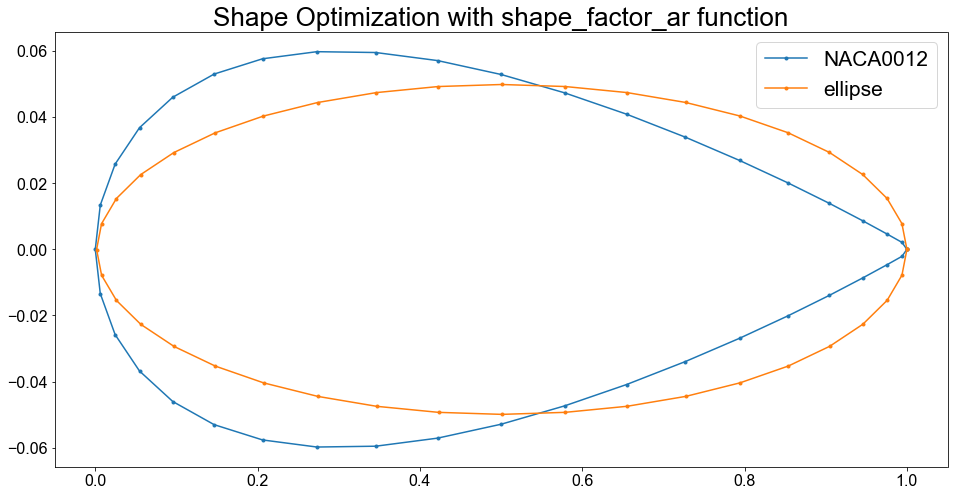

In [42]:
fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(111)
ax1.set_title('Shape Optimization with shape_factor_ar function', fontsize=26)
ax1.plot(x0[:,0], x0[:,1], '.-', label='NACA0012')
ax1.plot(x[:,0], x[:,1], '.-', label='ellipse')


ax1.legend(loc='best', fontsize=21)


# -------------------------------------Q8 End----------------------------------------------

# -----------------------------------6(Part2-Q5-Q8) END---------------------------------

## Items based on notebook four: <a class="tocSkip"></a>

# 8. Implementation of the Adjoint Method (15 points) <a class="tocSkip"></a>
Provide an implementation of the adjoint method to compute the derivative of the reduced optimisation problem as formulated in notebook four, question 1. Include the testing you have done to verify that the derivative is correct.

# 9. Implementation of the Airfoil Shape Optimisation (15 points) <a class="tocSkip"></a>
Show the results of the optimisation in question 2. of notebook four. Provide clear user documentation how a user might use the new optimisation functionality. Your code should be structured such that it is easy to use without too many inbetween steps for a novice user, but is still flexible to adapt for the expert user.

# -----------------------------------8(Part4-Q1)-------------------------------------------

The first of the two assignments in this notebook:

1. Implement the reduced functional `fhat(x)` that computes $\hat f(\vec x)=f(\vsig(\vec x), \vec x)$, and its derivative `grad_fhat(x)` which computes $d\hat f(\vec x)/d\vec x$. You should test the derivative using the `taylor_test`. A more efficient version of `taylor_test` is given at the end of the notebook. Note that if you use iterative solvers you will probably find the expected convergence rate to drop when the perturbation $h$ gets too small. You may want to switch to direct solvers temporarily. In step ii. you will need a solver for $\vlam$, you can simply use the same solver you use when solving for $\vsig$.

Hint: `fhat(x)` and `grad_fhat(x)` should be functions of `x` only, but you will find they depend on the `AirflowFunctional` object `af` and the upstream speed and angle `u_inf` and `alpha`. You may therefore find it easier to wrap them in a little class of the following form:

## Imports, Needed Functions (From assignment part 2), Airfoil functional class

In [43]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.linalg as sl
import scipy.sparse as sp
import scipy.sparse.linalg as spl
import scipy.optimize as sop
from matplotlib.tri import Triangulation, LinearTriInterpolator
from mpltools import annotation  # draws triangles in convergence plots

# ensure fonts in figures are readable:
plt.rcParams['font.size'] = 16
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial', 'Dejavu Sans']

# this module is provided with the notebook (potential_flow.py)
from potential_flow import *
from panel_method_derivatives import panel_method_x_derivative

# these two lines ensure that imported modules are automatically reloaded when changed
%load_ext autoreload
%autoreload 2

def shape_factor(x):
    """Computes the ratio l/sqrt{A}"""
    return length(x)/np.sqrt(area(x))

# derivative of the shape factor. dQ/dx = (2*A*l' - l*A')/(2*A^3/2)
def grad_shape_factor(x):
    numerator_term1 = 2*area(x)*grad_length(x) # 2*A*dL/dx
    numerator_term2 = length(x) * grad_area(x) # L*d/dx(A)
    dQdx =  (numerator_term1 - numerator_term2)/(2*(area(x))**(3/2)) # using the quotient rule
    return dQdx

def area(x):
    """Compute the area of the polygon x"""
    n = len(x)-1
    a = 0.
    for i in range(n):
        a += (x[i,0]-x[i+1,0])*(x[i,1]+x[i+1,1])/2.
    return a

def length(x):
    """Compute the length of the path described by the list of points x."""
    n = len(x)-1
    l = 0.
    for i in range(n):
        l += sl.norm(x[i+1]-x[i])
    return l

def grad_length(x):
    """Compute the gradient of length(x)."""
    n = len(x)-1
    dldx = np.zeros((n+1, 2))
    for i in range(n):
        dldx[i, 0] += -(x[i+1,0]-x[i,0])/sl.norm(x[i+1]-x[i])
        dldx[i+1, 0] += (x[i+1,0]-x[i,0])/sl.norm(x[i+1]-x[i])
        dldx[i, 1] += -(x[i+1,1]-x[i,1])/sl.norm(x[i+1]-x[i])
        dldx[i+1, 1] += (x[i+1,1]-x[i,1])/sl.norm(x[i+1]-x[i])
    return dldx

def grad_area(x):
    """Compute the gradient of area(x)."""
    n = len(x)-1
    dadx = np.zeros((n+1, 2))
    for i in range(n):
        dadx[i, 0] += 0.5*(x[i,1]+x[i+1,1])
        dadx[i+1, 0] += -0.5*(x[i,1]+x[i+1,1])
        dadx[i, 1] += 0.5*(x[i,0]-x[i+1,0])
        dadx[i+1, 1] += 0.5*(x[i,0]-x[i+1,0])
    return dadx

class AirfoilFunctional:
    """A functional combining lift and shape_factor of an airfoil.
    
    This functional relies on the functions shape_factor(), grad_shape_factor, length(x),
    and grad_length(x) being defined elsewhere"""
    def __init__(self, verbose=True, aspect_ratio=20.0, Q_max=3.8, Q_scale=1e-2, Q_eps=1e-4):
        """
        verbose - if true print lift and shape factor and combined function value at each evaluation
        aspect_ratio - used in shape_factor: aspect ratio of ellipse that has minimal value for Q
        Q_max - maximal allowable value for shape factor Q
        Q_scale - scales the penalty parameter
        Q_eps - cap log term at this distance from Q_max
        """
        self.verbose = verbose
        self.aspect_ratio = aspect_ratio
        self.Q_max = Q_max
        self.Q_scale = Q_scale
        self.Q_eps = Q_eps
        
    def shape_factor_ar(self, x):
        """Rescaled shape_factor that is minimal for an ellipse of the specified aspect ratio."""
        x[:,1] *= self.aspect_ratio  # scale y-coordinates: ellipse -> circle
        Q = shape_factor(x)
        x[:,1] /= self.aspect_ratio   # change back y-coords
        return Q

    def grad_shape_factor_ar(self, x):
        """Gradient of shape_factor_ar"""
        x[:,1] *= self.aspect_ratio  # scale y coordinates: ellipse -> circle
        dQdx = grad_shape_factor(x)
        x[:,1] /= self.aspect_ratio  # change back y-coords
        # also rescale the y-derivatives:
        dQdx[:,1] *= self.aspect_ratio
        return dQdx
    
    def f(self, sigma, x):
        """Functional: f(sigma, x) = -lift + Q_scale * shape_factor"""
        lift = -2*sigma[-1] * length(x)
        Q = self.shape_factor_ar(x)
        penalty = - self.Q_scale * np.log(np.maximum(self.Q_max-Q, self.Q_eps))
        if self.Q_max-Q<self.Q_eps:
            penalty += self.Q_scale * (Q-self.Q_max+self.Q_eps)/self.Q_eps

        f_value = -lift + penalty
        if self.verbose:
            print("C_L, Q, penalty, f(sigma, x)", lift, Q, penalty, f_value)

        return f_value
    
    def grad_x_f(self, sigma, x):
        """Partial derivative of f with respect to x"""
        # only the shape factor term explicitly depends on x
        Q = self.shape_factor_ar(x)
        g = self.Q_scale * self.grad_shape_factor_ar(x) / np.maximum(self.Q_max-Q, self.Q_eps)
        g += 2*sigma[-1] * grad_length(x)
        return g
    
    def grad_sigma_f(self, sigma, x):
        """Partial derivative of f with respect to sigma"""
        g = np.zeros_like(sigma)
        g[-1] = 2. * length(x)
        return g

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Class for the Reduced Airfoil Functional and its gradient

In [44]:
class ReducedAirfoilFunctional:
    
    def __init__(self, af, u_inf=1., alpha=0.):
        self.af = af
        self.u_inf = 1.
        self.alpha = 0.
    
    def fhat(self, x):
        """ The reduced functional """
        # TODO: compute fhat(x) = f(sigma(x), x)

        # get sigma from x i.e. sigma(x)
        #---
        pfpm = PotentialFlowPanelMethod(x, self.u_inf, self.alpha)
        A, b = pfpm.assemble()
        sigma_x = sl.solve(A, b)
        #---
        
        # get fhat by substituting sigma(x) and x into the functional f. 
        #---
        a = AirfoilFunctional()
        fhat = af.f(sigma_x, x)
        #---
        
        return fhat
    
    
    def grad_fhat(self, x):
        """ The partial derivative of the reduced functional wrt x """
        # TODO: compute dfhat(x)/dx
        
        # get sigma from x
        #---
        pfpm = PotentialFlowPanelMethod(x, self.u_inf, self.alpha)
        A, b = pfpm.assemble()
        sigma = sl.solve(A, b)
        #---

        # calculate lambda (by solving A^T lambda  = (df/ds)^T )
        # ---
        dfds = af.grad_sigma_f(sigma, x)
        dfds_Transpose = dfds.transpose()
        A_Transpose = A.transpose()
        lam = sl.solve(A_Transpose, dfds_Transpose) #lambda
        # ---
        
        # calculate grad_fhat (d/dx(f_reduced))
        # ---
        dfdx = af.grad_x_f(sigma, x)
        dgdx = panel_method_x_derivative(sigma, x, self.u_inf, self.alpha)
        lambda_dot_dgdx = np.tensordot(lam, dgdx, ((0,), (0,)))  # \sum_i lam_i*dgdx_ijk
        
        dfr_dx = dfdx - lambda_dot_dgdx
        # ---
        
        return(dfr_dx)     

## Taylor Test

In [45]:
def taylor_test(f, grad_f, x, h0, max_iter=20, plot_convergence=True, print_convergence=True):
    """Taylor test to verify that the function grad_f is the derivative of the function `f`
    
    We test:
    
       f(x + h) = f(x) + grad_f(x).h + O(h^2)
    
    f, grad_f  - function and its derivative to test
    x          - point in which to test
    h0         - initial perturbation
    max_iter   - number of times that h is halved
    plot_convergence - whether to plot the convergence of the Taylor residual f(x+h)-f(x)-grad_f(x).h
    print_convergence - prints the order of convergence between subsequent iterations."""


    h = h0.copy()
    residuals = []
    hnorms = []
    fx = f(x)
    gradfx = grad_f(x)
    for i in range(max_iter):
        r = f(x + h) - fx - np.tensordot(gradfx, h, len(h.shape))
        residuals.append(sl.norm(r))
        hnorms.append(sl.norm(h))
        h /= 2.

    if plot_convergence:
        fig, ax = plt.subplots(1,2, figsize=(16,4))
        ax[0].semilogy(residuals)
        ax[0].set_xlabel('iteration')
        ax[0].set_ylabel('Taylor residual $|r|$')
        ax[0].set_xticks(range(0,max_iter,2))
        ax[1].loglog(hnorms, residuals)
        ax[1].set_xlabel('perturbation size $\|h\|$')
        ax[1].set_ylabel('Taylor residual $|r|$')

        # NOTE: slope_marker does not seem to work in semilogy plots
        annotation.slope_marker((1e-3, 1e-1), (2, 1), invert=True, ax=ax[1], size_frac=.2)

    if print_convergence:
        residuals = np.array(residuals)
        print('Order of convergence, log(r(h_i)/r(h_{i+1}))/log(2):')
        print(np.log(residuals[:-1]/residuals[1:])/np.log(2))

C_L, Q, penalty, f(sigma, x) -6.401626188301828e-16 4.254208081494124 45.52291155313214 45.52291155313214
C_L, Q, penalty, f(sigma, x) -16.752342392562962 199.52154726953364 19572.25683035708 19589.009172749644
C_L, Q, penalty, f(sigma, x) 23.327309804444006 59.766758422281825 5596.777945631903 5573.450635827459
C_L, Q, penalty, f(sigma, x) 9.13263263355774 31.160986371812484 2736.2007405849677 2727.0681079514097
C_L, Q, penalty, f(sigma, x) 2.9041702660413633 17.27948609535541 1348.0507129392606 1345.1465426732193
C_L, Q, penalty, f(sigma, x) -0.010571204447368874 10.037626500181073 623.8647534218271 623.8753246262745
C_L, Q, penalty, f(sigma, x) 1.3107365841573055 6.431875162590749 263.2896196627947 261.97888307863735
C_L, Q, penalty, f(sigma, x) -0.3459898388508259 4.931980237650927 113.30012716881245 113.64611700766328
C_L, Q, penalty, f(sigma, x) 0.344858313216983 4.429045828701732 63.00668627389293 62.66182796067595
C_L, Q, penalty, f(sigma, x) 0.1797693602953357 4.28668312833478

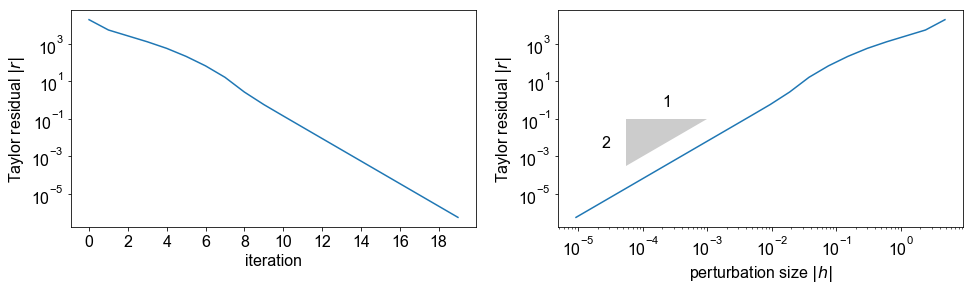

In [46]:
x = np.loadtxt('naca0012.dat')  # load the vertices of the polygon of a standard airfoil

af = AirfoilFunctional()
RAF = ReducedAirfoilFunctional(af)
n = 40
h0 = np.random.random((n+1, 2))

taylor_test(RAF.fhat, RAF.grad_fhat, x, h0)

## Observation
We observe that the order of convergence, computed from subsequent iterations, rapidly reaches the expected value of 2.

# ---------------------------------8(Part4-Q1) End----------------------------------------

# ---------------------------------9(Part4-Q2)---------------------------------------------

2. Perform an airfoil optimisation with the given default values of the functional parameters: `Q_max=3.8`, and `aspect_ratio=20.`,  and use `u_inf=1` and `alpha=0` for the upstream flow. You do not need to analyse here which optimisation algorithm performs best. Just choose one that is appropriate and works for you. After obtaining the optimal shape, take this shape as the input to a single run of the panel method and evaluate its lift coefficient (using the `lift_coefficient` method in the same way as in notebook three) and do the same using the finite element method (`KuttaPotentialFlowFE`). This way you can verify that the predicted optimal shape has indeed improved the lift of the airfoil. After this try another at least one other `aspect_ratio` and show the results.

In [47]:
class VerticalShapeOptimisation:
    """Shape optimisation based on a polygon, in which the vertices are moved vertically only
    
    The first and last vertex of this polygon, described a list of vertices
    should be the same and will not be changed during the optimisation."""
    def __init__(self, x0, f_user, grad_f_user, store_function_evaluations=True, store_gradient_evaluations=True):
        """
        x0     - the initial polygon of n edges, described by a shape (n+1,2) array of vertex positions,
                 where the first and last vertex should be the same to describe a closed polygon
        f_user      - the function that computes the objective values, should take a shape (n+1,2) array
        grad_f_user - function that computes the gradient of f, should take and return a shape (n+1,2) array
        store_function_evaluations, store_gradient_evaluations - if either set to true, self.x_i stores
                                                                 a list of (n+1,2) arrays representing
                                                                 the polygons for which the function or 
                                                                 gradient was evaluated."""        
        self.f_user = f_user
        self.grad_f_user = grad_f_user
        self.x0 = x0.copy()  # we keep a copy of the original polygon
        self.x = x0.copy()  # this is the copy we are actually going to change
        self.n = len(x0)-1
        self.x_i = []  # stores subsequent iterations when asked for
        self.store_function_evaluations = store_function_evaluations
        self.store_gradient_evaluations = store_gradient_evaluations
        
    def minimize(self, *args, **kwargs):
        """Wrapper around scipy.optimize.minimize
        
        Passes the correct function, gradient and initial guess. Any further arguments are also passed on
        to scipy's minimize"""
        # make a copy of x0, so that if we call minimize() again
        # we again start from the same initial guess provided in __init__()
        self.x = self.x0.copy()
        # now turn that into a flat vector
        x0_vec = self.get_x_vec()
        return sop.minimize(self.f, x0_vec, jac=self.jac, *args, **kwargs)
        
    def set_x(self, x_vec):
        """Set self.x based on the (n-1)-vector used by scipy minimize"""
        # copy into self.x, leaving first and last vertex unchanged:
        self.x[1:self.n, 1] = x_vec
        
    def get_x_vec(self):
        """Obtain the (n-1)-vector from self.x"""
        return self.x[1:self.n,1].copy()
                
    def f(self, x_vec):
        """Wrapper function f, called by scipy's minimize"""
        self.set_x(x_vec)
        if self.store_function_evaluations:
            self.x_i.append(self.x.copy())
        f = self.f_user(self.x)
        return f
    
    def jac(self, x_vec):
        """Wrapper gradient function, called by scipy's minimize"""
        self.set_x(x_vec)
        if self.store_gradient_evaluations:
            self.x_i.append(self.x.copy())
        grad = self.grad_f_user(self.x)
        return grad[1:self.n,1].copy()  # skip gradient associated with first and last vertex

## Main Function to optimize the Airfoil Configuration

Note: This function works the way it should in the first run, but if you run it the second time it will do exactly the same thing as the first time (I could't figure out why this is happening but we don't necessarly need this function; we can do what it does on a cell with only a few lines (as in the last cell of this notebook) ).

In [48]:
def optimize_airfoil(vertices='naca0012.dat', info=True, aspectratio=20.0, Qmax=3.8, Qscale=1e-2, Qeps=1e-4, uinf=1., angle=0. ,tolerance =0.01, plot=True):
    """
    Shape optimisation based on a polygon, in which the vertices are moved vertically only:
    
    vertices -  string: filename containing the the vertices of the polygon of a standard airfoil
    info - bool: if true print lift and shape factor and combined function value at each evaluation
    aspect_ratio - float: used in shape_factor: aspect ratio of ellipse that has minimal value for Q
    Qmax - float: maximal allowable value for shape factor Q
    Qscale - float: scales the penalty parameter
    Qeps - float: cap log term at this distance from Q_max
    uinf - float: u_inf
    angle - float: angle of attack
    tolerance - float: the tolerance for the minimize function
    plot - bool: if true will plot the evolution of the airfoil configurstion
    
    """

    x = np.loadtxt(vertices);  # load the vertices of the polygon of a standard airfoil
    af = AirfoilFunctional(verbose=bool(info), aspect_ratio=aspectratio, Q_max=Qmax, Q_scale=Qscale, Q_eps=Qeps); # this object is to pass the functional into the ReducedAirfoilFunctional object below
    print("af.verbose, af.aspect_ratio = ",af.verbose, af.aspect_ratio);
    
    RAF = ReducedAirfoilFunctional(af,u_inf=uinf, alpha=angle);
    print("RAF.u_inf, alpha = ", RAF.u_inf, RAF.alpha);


    x0 = np.loadtxt(vertices);
    vso = VerticalShapeOptimisation(x0, RAF.fhat, RAF.grad_fhat); # create an object for verical shape optimization minimizing the reduced functional (RAF.fhat)
    result = vso.minimize(method='BFGS', tol=tolerance);
    
    #--- Plot the airfoil Configuration ---
    if(plot==True):
        for i, xn in enumerate(vso.x_i[:]):
            plt.figure(figsize=(16,4))
            plt.plot(xn[:,0], xn[:,1], '.-')
            plt.axis('equal')
            plt.title('Evaluation {}'.format(i))
            plt.show()
    #---
    
    return result

## Lets do the optimisation

af.verbose, af.aspect_ratio =  True 20.0
RAF.u_inf, alpha =  1.0 0.0
C_L, Q, penalty, f(sigma, x) -6.401626188301828e-16 4.254208081494124 45.52291155313214 45.52291155313214
C_L, Q, penalty, f(sigma, x) -1.247184053947103 114.66419565923859 11086.521669327578 11087.768853381525
C_L, Q, penalty, f(sigma, x) 0.21859205252507166 11.064730291088976 726.5751325126174 726.3565404600923
C_L, Q, penalty, f(sigma, x) 0.010670176135686403 4.240222725886882 44.124375992408005 44.11370581627232
C_L, Q, penalty, f(sigma, x) 0.012517360826522392 4.215752242043623 41.67732760808204 41.66481024725552
C_L, Q, penalty, f(sigma, x) 0.01639404592931319 4.171961973902594 37.29830079397915 37.28190674804984
C_L, Q, penalty, f(sigma, x) 0.02254541386148368 4.122540772988828 32.356180702602614 32.33363528874113
C_L, Q, penalty, f(sigma, x) 0.027100630921465623 4.063765236055359 26.478627009255714 26.451526378334247
C_L, Q, penalty, f(sigma, x) 0.02946655048307991 4.075765778757387 27.678681279458488 27.64921

C_L, Q, penalty, f(sigma, x) 0.908900631734027 3.799813425003255 0.08586677272394595 -0.8230338590100811
C_L, Q, penalty, f(sigma, x) 0.9156943738790545 3.7995589222912325 0.07726289487683882 -0.8384314790022157
C_L, Q, penalty, f(sigma, x) 0.9472446428312974 3.79970116187129 0.08115608506722419 -0.8660885577640732
C_L, Q, penalty, f(sigma, x) 0.993513763069947 3.800285880401298 0.13069144384960177 -0.8628223192203452
C_L, Q, penalty, f(sigma, x) 0.9710574099038995 3.799771727815451 0.0838497184913111 -0.8872076914125885
C_L, Q, penalty, f(sigma, x) 1.0218308596688233 3.8003521337647683 0.13731678019661211 -0.8845140794722112
C_L, Q, penalty, f(sigma, x) 0.9952249393312866 3.7999453140026174 0.0966348039815165 -0.8985901353497702
C_L, Q, penalty, f(sigma, x) 1.0093360485046643 3.7999024474890093 0.09234815262070897 -0.9169878958839554
C_L, Q, penalty, f(sigma, x) 1.023642738899608 3.799718939533682 0.0817694072915291 -0.941873331608079
C_L, Q, penalty, f(sigma, x) 1.0728514127351576 3.

C_L, Q, penalty, f(sigma, x) 1.4840626887653061 3.7957275961692805 0.05455578652129118 -1.429506902244015
C_L, Q, penalty, f(sigma, x) 1.4840546492360198 3.79572412612698 0.054547667827417455 -1.4295069814086023
C_L, Q, penalty, f(sigma, x) 1.4840505045437882 3.7957223393150787 0.054543489877553586 -1.4295070146662345
C_L, Q, penalty, f(sigma, x) 1.4840490861019693 3.7957217211102106 0.054542044788177105 -1.4295070413137922
C_L, Q, penalty, f(sigma, x) 1.4840503661448612 3.7957222579605667 0.05454329969477754 -1.4295070664500837
C_L, Q, penalty, f(sigma, x) 1.4840533751748326 3.7957235373076057 0.05454629084845837 -1.4295070843263742
C_L, Q, penalty, f(sigma, x) 1.4840563137246503 3.795724787847278 0.05454921551457074 -1.4295070982100795
C_L, Q, penalty, f(sigma, x) 1.4840586842543415 3.795725794543503 0.05455157051996576 -1.4295071137343758
C_L, Q, penalty, f(sigma, x) 1.484059487676381 3.795726130717217 0.05455235706833981 -1.4295071306080414
C_L, Q, penalty, f(sigma, x) 1.4840580467

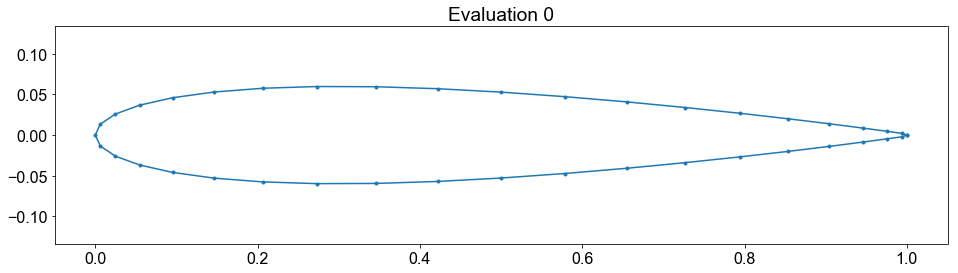

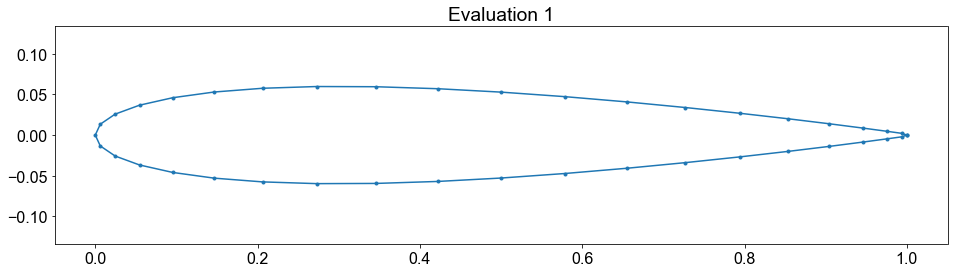

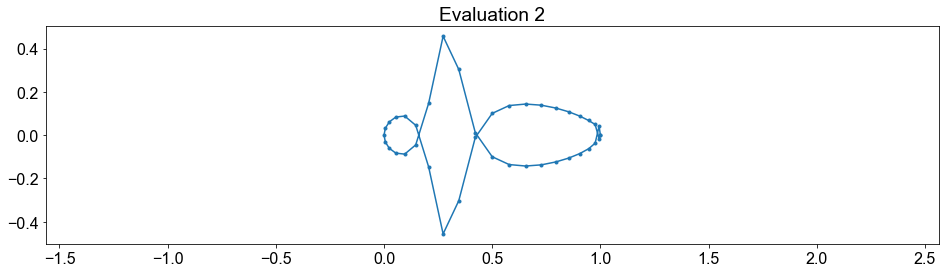

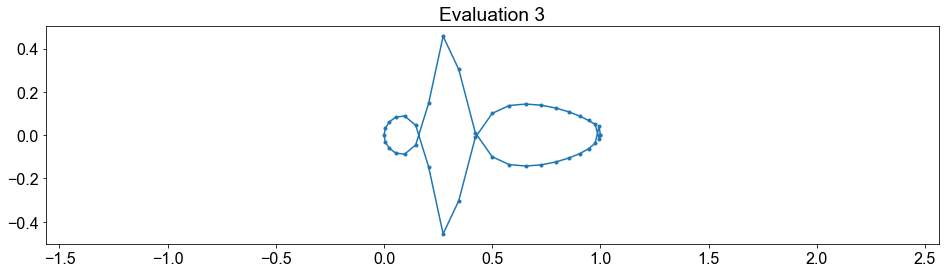

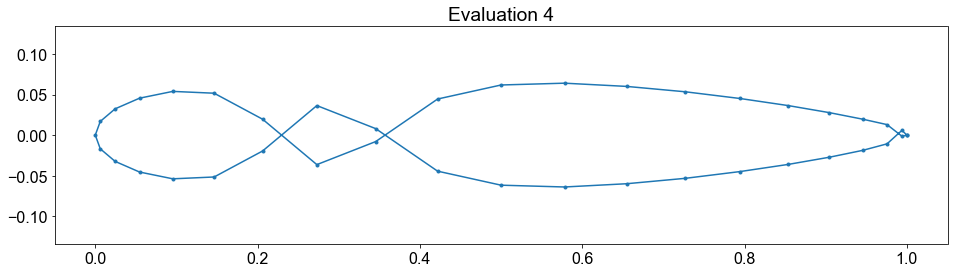

...

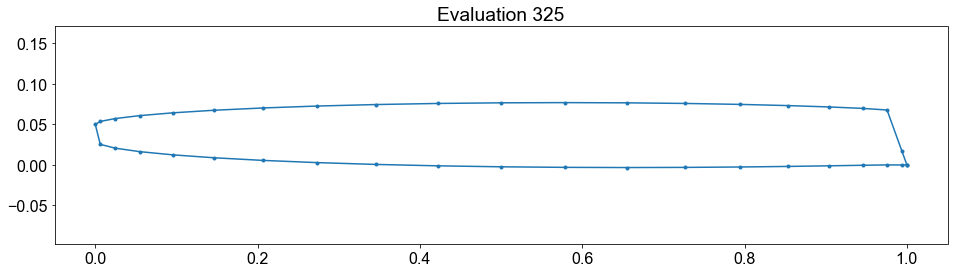

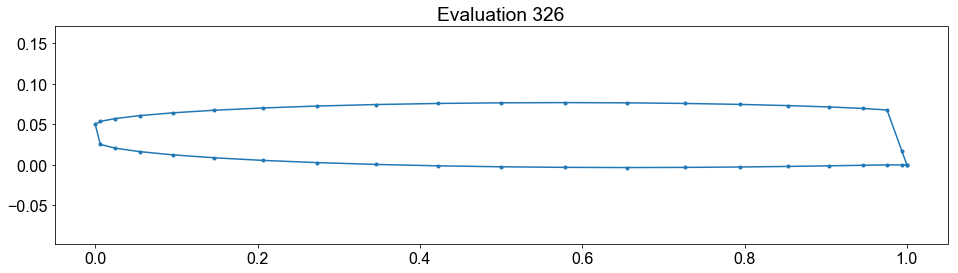

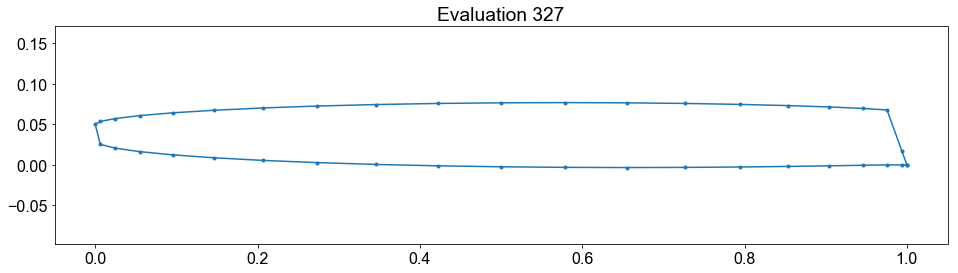

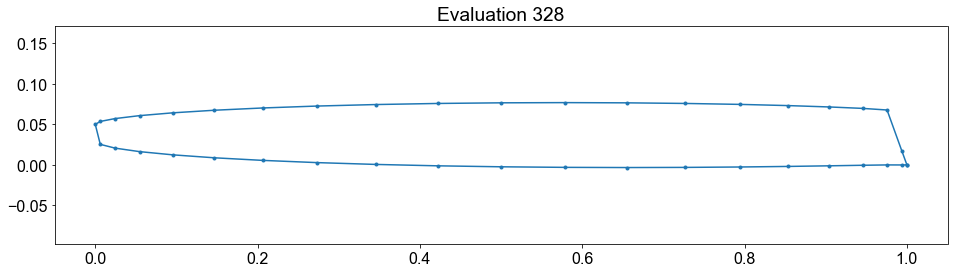

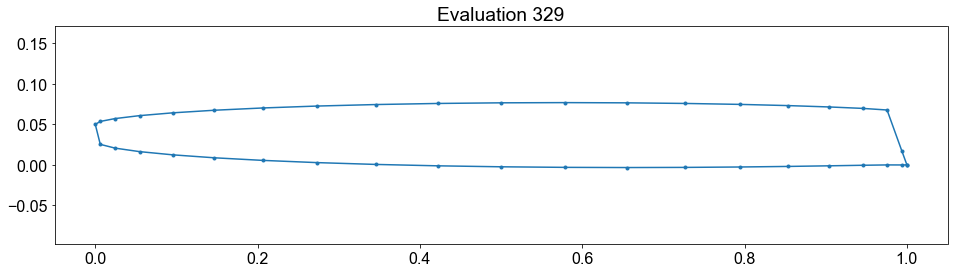

In [49]:
result1 = optimize_airfoil(vertices='naca0012.dat', info=True, aspectratio=20.0, Qmax=3.8, Qscale=1e-2, Qeps=1e-4, uinf=1., angle=0. ,tolerance =0.01, plot=True)

## Verification

After obtaining the optimal shape, we take this shape as the input to a single run of the panel method and evaluate its lift coefficient (using the lift_coefficient method in the same way as in notebook three) and do the same using the finite element method (KuttaPotentialFlowFE). By comparing the previous lift values (from part 3) to the new airfoil lift values we verify that the predicted optimal shape has indeed improved the lift of the airfoil.

In [50]:
# optimize airfoil from part 3
#---
airfoil = np.loadtxt('naca0012.dat')
u_inf = 1.
alpha = np.deg2rad(0)

pfpm = PotentialFlowPanelMethod(airfoil, u_inf=1, alpha=0)
A, b = pfpm.assemble()
sigma = sl.solve(A, b)
print("pfpm lift (from part 3) = ", pfpm.lift_coeffcient(sigma))

u_inf = 1.
alpha = 0
resolution = 1e-2
# polygon describing the outer boundary
outer_boundary = [[-2, -2], [3, -2], [3, 2], [-2, 2], [-2, -2]]
kpf = KuttaPotentialFlowFE(airfoil, outer_boundary, resolution, u_inf=1, alpha=0)
A, b = kpf.assemble()
# solve it
phi = spl.spsolve(A, b)
print("kpf lift (from part 3) = ", kpf.lift_coeffcient(phi))
#---

# optimize airfoil from part 4
#---
airfoil = np.loadtxt('naca0012.dat')

pfpm = PotentialFlowPanelMethod(airfoil, u_inf=1, alpha=0)

airfoil = np.loadtxt('naca0012.dat')

pfpm = PotentialFlowPanelMethod(airfoil, u_inf=1, alpha=0)
print("pfpm lift (from part 4) = ", pfpm.lift_coeffcient(result1.x))
print("kpf lift (from part 4) = ", kpf.lift_coeffcient(result1.x))

#---

pfpm lift (from part 3) =  -6.040263011551868e-16
kpf lift (from part 3) =  -0.002864351164095319
pfpm lift (from part 4) =  0.0003196458308019042
kpf lift (from part 4) =  0.0001567988615747005


## Observations
Above it is observed that the new optimised airfoil configuration produces better Lift values ( both the kutta potential flow and the Panel methods give better lift values) for functional parameters: Q_max=3.8, and aspect_ratio=20., and use u_inf=1 and alpha=0.

## Repeat with an aspect ratio of 10

C_L, Q, penalty, f(sigma, x) -6.401626188301828e-16 3.720201874593224 0.025282552659454546 0.025282552659455188
C_L, Q, penalty, f(sigma, x) 2.484467517619084 29.849581661198606 2605.06026952358 2602.5758020059607
C_L, Q, penalty, f(sigma, x) 0.08299366182029828 3.7237388961499986 0.02573592249834489 -0.057257739321953396
C_L, Q, penalty, f(sigma, x) 0.2716735163627312 3.837182148448077 3.8203182485274607 3.5486447321647296
C_L, Q, penalty, f(sigma, x) 0.11723757585645568 3.7346656110256533 0.02728236750779655 -0.08995520834865914
C_L, Q, penalty, f(sigma, x) 0.5240847444030068 3.8810804066886138 8.210144072581155 7.686059328178148
C_L, Q, penalty, f(sigma, x) 0.12055561564584714 3.7362190859877975 0.02752301286800458 -0.09303260277784256
C_L, Q, penalty, f(sigma, x) 0.12377125038638166 3.7377622650575444 0.027767937920869512 -0.09600331246551215
C_L, Q, penalty, f(sigma, x) 0.28810184153967544 3.8071699168035984 0.8190950840796193 0.5309932425399438
C_L, Q, penalty, f(sigma, x) 0.1690

C_L, Q, penalty, f(sigma, x) 0.644312972031504 3.799820085128065 0.08623026752638001 -0.558082704505124
C_L, Q, penalty, f(sigma, x) 0.6579437574482366 3.7996080211698344 0.0784430272431223 -0.5795007302051143
C_L, Q, penalty, f(sigma, x) 0.6937750067251796 3.7996949966925757 0.08095187937402176 -0.6128231273511577
C_L, Q, penalty, f(sigma, x) 0.7698720886138608 3.800781882983276 0.18029170204738126 -0.5895803865664795
C_L, Q, penalty, f(sigma, x) 0.7219482408573813 3.7999178364164816 0.0938870453679416 -0.6280611954894397
C_L, Q, penalty, f(sigma, x) 0.7428479631524699 3.799914477709434 0.093551174663182 -0.649296788489288
C_L, Q, penalty, f(sigma, x) 0.762454818253727 3.799729480409695 0.08215166039730823 -0.6803031578564187
C_L, Q, penalty, f(sigma, x) 0.828811919450998 3.8002703245745892 0.12913586117870382 -0.6996760582722942
C_L, Q, penalty, f(sigma, x) 0.8327109679626431 3.8000608816843187 0.10819157215164546 -0.7245193958109977
C_L, Q, penalty, f(sigma, x) 0.8302870668383306 3.

C_L, Q, penalty, f(sigma, x) 2.2604843719947243 3.7996832564718463 0.08057418171004996 -2.1799101902846743
C_L, Q, penalty, f(sigma, x) 2.3174224025805596 3.800553188336415 0.1574222373612996 -2.16000016521926
C_L, Q, penalty, f(sigma, x) 2.2790655580482158 3.7998362011524205 0.08716871422105264 -2.191896843827163
C_L, Q, penalty, f(sigma, x) 2.3005107264902587 3.799868730285586 0.08938256462713012 -2.2111281618631287
C_L, Q, penalty, f(sigma, x) 2.3231534894885817 3.7997336643234716 0.0823075310292648 -2.240845958459317
C_L, Q, penalty, f(sigma, x) 2.400648450748263 3.8009420587665455 0.19630928037432466 -2.2043391703739386
C_L, Q, penalty, f(sigma, x) 2.3465737638510085 3.7999189621213882 0.09399961585860397 -2.2525741479924046
C_L, Q, penalty, f(sigma, x) 2.3628395388013232 3.79988428546607 0.09064384314282287 -2.2721956956585005
C_L, Q, penalty, f(sigma, x) 2.379741200677313 3.799684274512255 0.08060637431593227 -2.2991348263613807
C_L, Q, penalty, f(sigma, x) 2.439447646466148 3.8

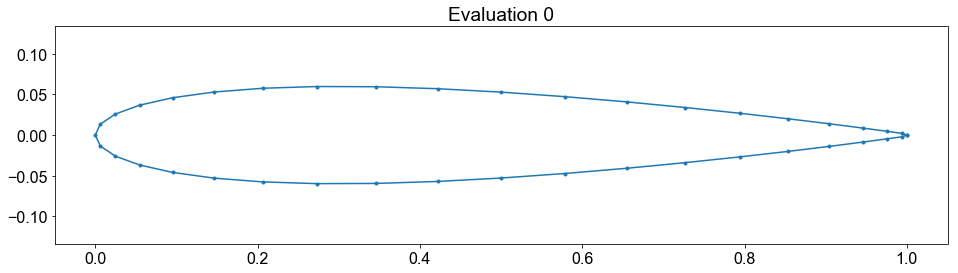

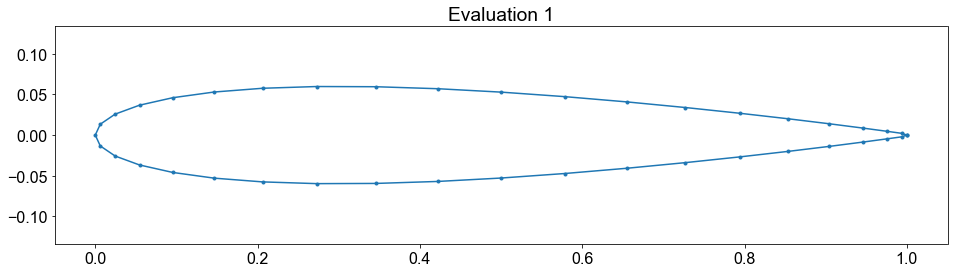

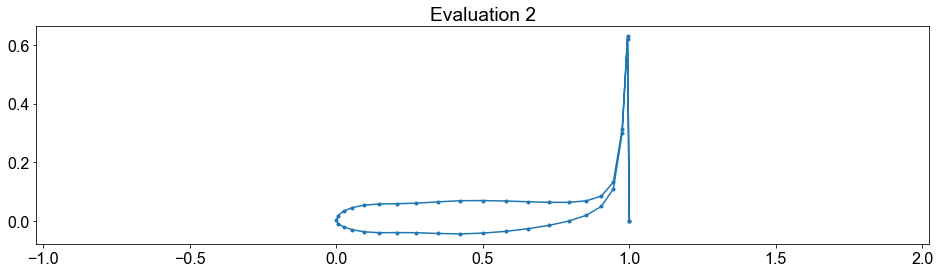

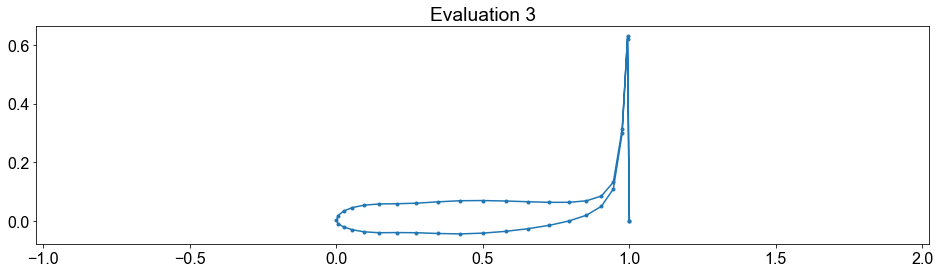

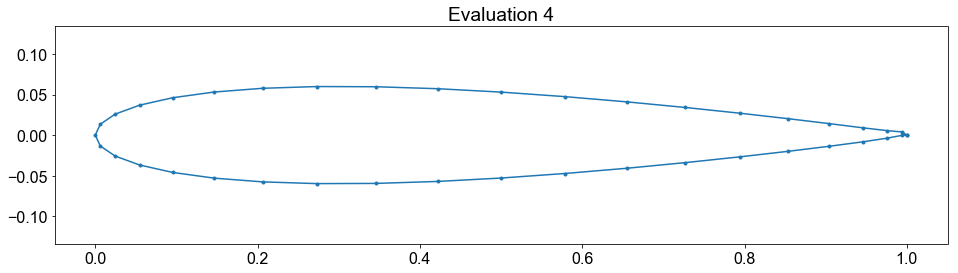

...

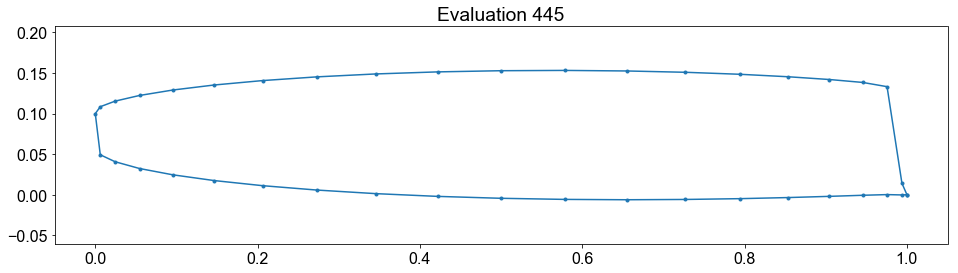

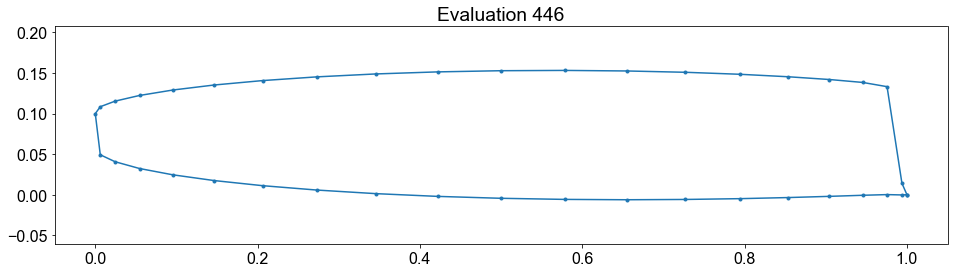

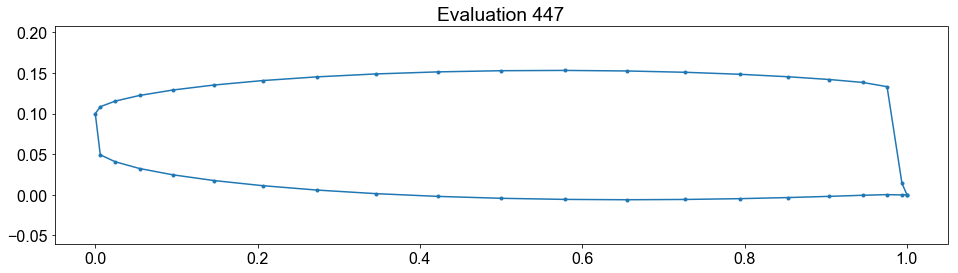

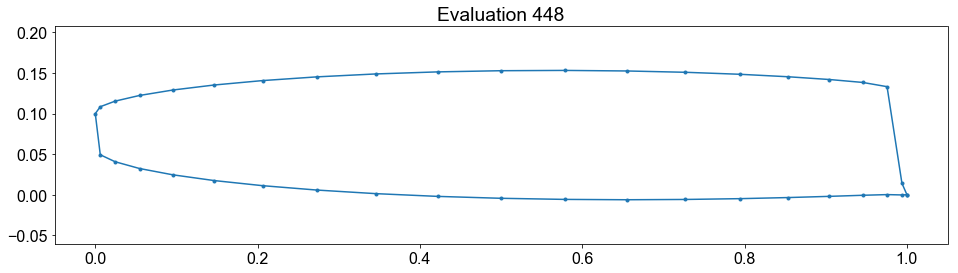

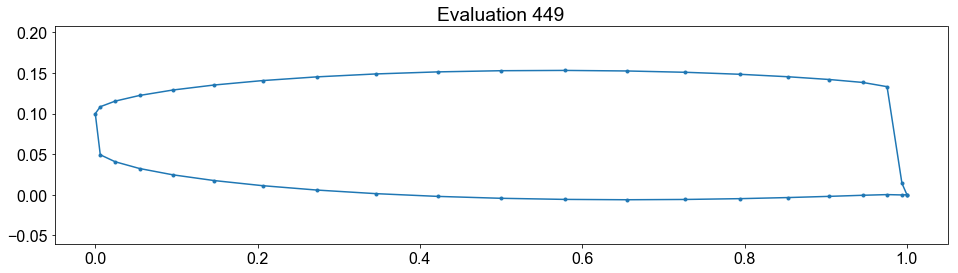

In [51]:
# ideally we should be able to use:
#---
# result2 = optimize_airfoil(vertices='naca0012.dat', info=True, aspectratio=10, Qmax=3.8, Qscale=1e-2, Qeps=1e-4, uinf=1., angle=0. ,tolerance =0.01, plot=True)
#---
# but for some reason this would give us the previous result1 (with aspect ratio of 20)



# Let's optimize manually instead:
#---
#below are the input parameters to the function optimize_airfoil (see the documentaion above)
vertices='naca0012.dat'; info=True; aspectratio=10.0; Qmax=3.8; Qscale=1e-2; Qeps=1e-4; uinf=1.; angle=0.; tolerance =0.01; plot=True;

x = np.loadtxt(vertices)  # load the vertices of the polygon of a standard airfoil
af = AirfoilFunctional(verbose=bool(info), aspect_ratio=aspectratio, Q_max=Qmax, Q_scale=Qscale, Q_eps=Qeps) # this object is to pass the functional into the ReducedAirfoilFunctional object below

RAF = ReducedAirfoilFunctional(af,u_inf=uinf, alpha=angle)

x0 = np.loadtxt(vertices)
vso = VerticalShapeOptimisation(x0, RAF.fhat, RAF.grad_fhat) # create an object for verical shape optimization minimizing the reduced functional (RAF.fhat)
result2 = vso.minimize(method='BFGS', tol=tolerance)
#---

#plot the airfoil configurations
for i, x in enumerate(vso.x_i[:]):
    plt.figure(figsize=(16,4))
    plt.plot(x[:,0], x[:,1], '.-')
    plt.axis('equal')
    plt.title('Evaluation {}'.format(i))
    plt.show()

# -----------------------------------9(Part4-Q2)End---------------------------------------